In [ ]:
#upload the zip file that contains the original, missing and imputed csv files for each of the three datasets - spam, college, letter (gain_data.zip from repo)
from google.colab import files
uploaded = files.upload()

Saving gain_data.zip to gain_data.zip


In [ ]:

import zipfile
import io
zf = zipfile.ZipFile(io.BytesIO(uploaded['gain_data.zip']), "r")
zf.extractall()

In [ ]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy import stats
import matplotlib.patches as mpatches
from sklearn import linear_model


pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#set style for plt
plt.style.use('fivethirtyeight')

In [ ]:
###to run the same code for other dataset, just change the college.csv with other csv along with imputed and missing csv
#dframe creation
dataset = 'college'
filename = dataset + '/' + dataset +'.csv'

original_df = pd.read_csv(filename)
all_col_names = original_df.columns.to_list()

mis_col_names = [i+'_mis' for i in all_col_names]
imp_col_names = [i+'_imp' for i in all_col_names]

miss_filename = dataset +'/missing.csv'
imp_filename = dataset +'/imputed.csv'
miss_df = pd.read_csv(miss_filename,names= mis_col_names)
imp_df = pd.read_csv(imp_filename,names= imp_col_names)

df4 = original_df.join(miss_df)
combined_df = df4.join(imp_df)


In [ ]:
####function to get df which has original values and imputed values
def getdf(df,col):
  col_mis = col + '_mis'
  col_imp = col + '_imp'
  idx = df[df[col_mis].isnull()].index.tolist()
  ans_df = df.iloc[idx]
  ans_df = ans_df[[col,col_imp]]
  return ans_df
  

In [ ]:
###function to plot dula line graph of first 100 records of a particular feature, input - specific df and col name
def plotlinegraph(df,x):
  plt.figure(figsize=(24, 8))
  sns.lineplot(data=df.tail(200))
  plt.title("Original and Imputed Values for feature " + x)
  plt.xlabel('records')
  plt.ylabel('value')
  plt.show()

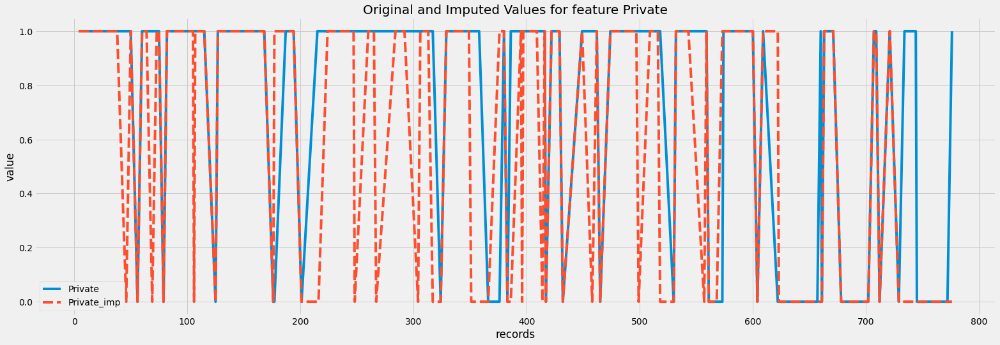

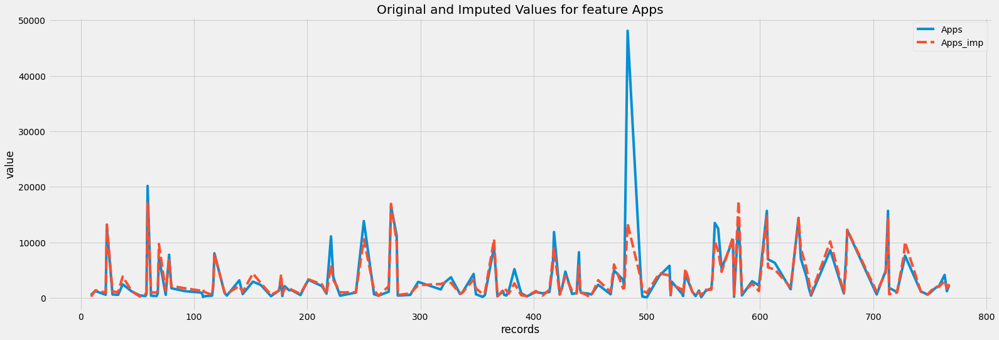

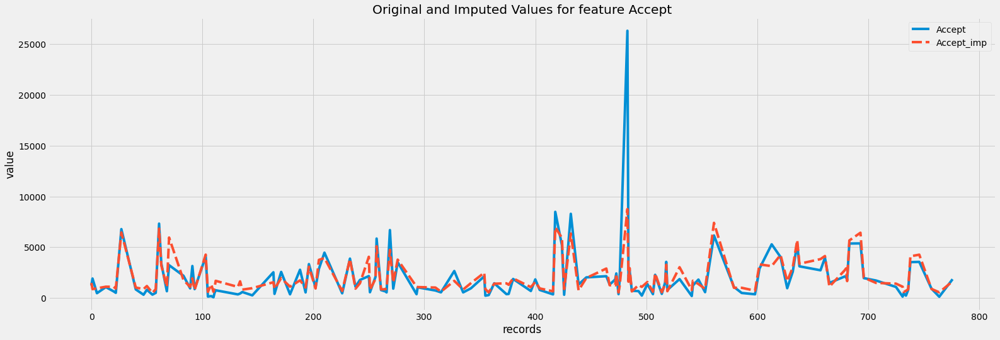

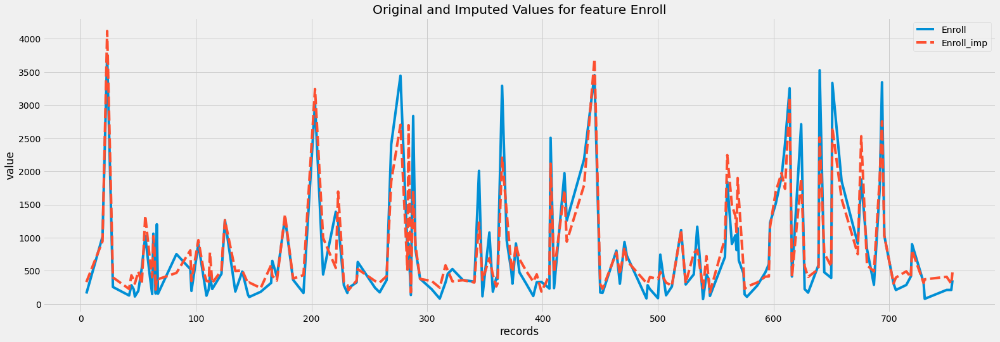

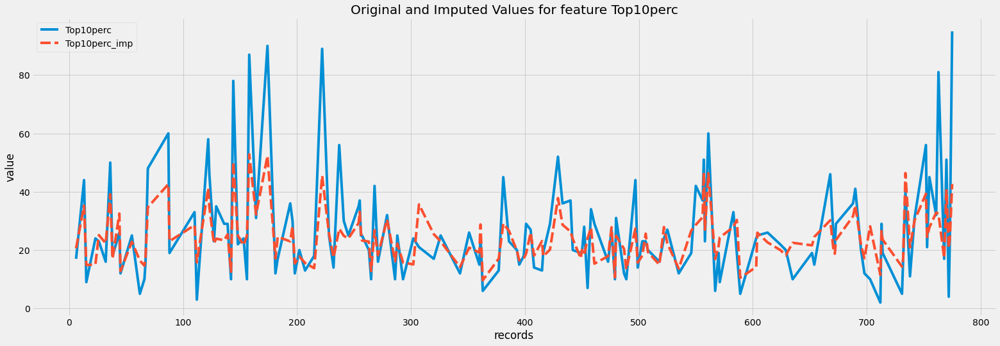

...

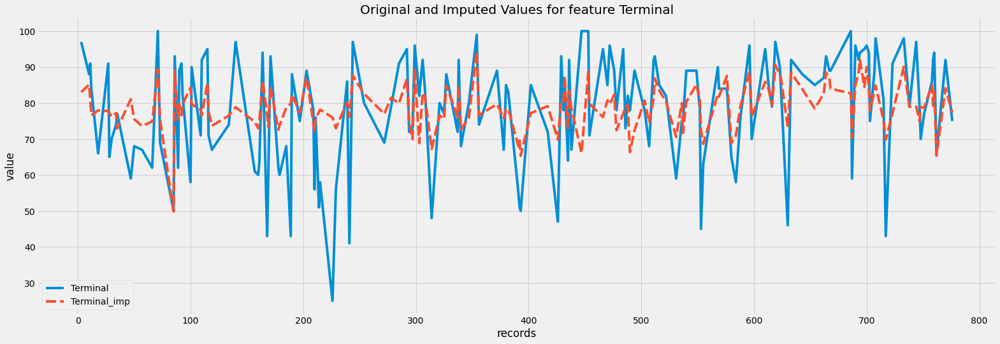

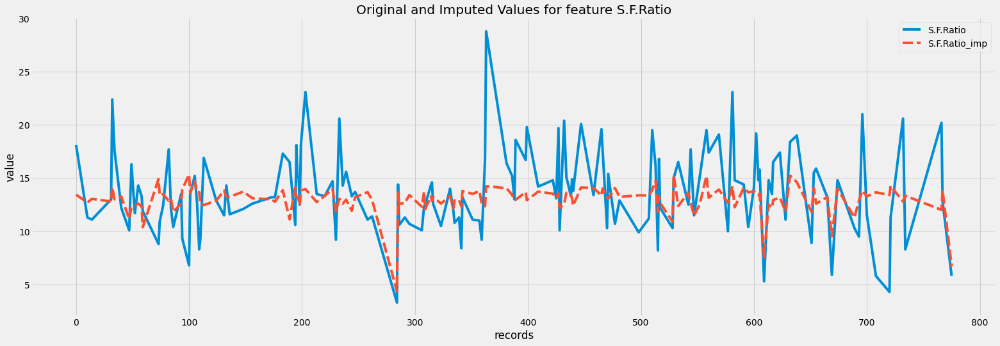

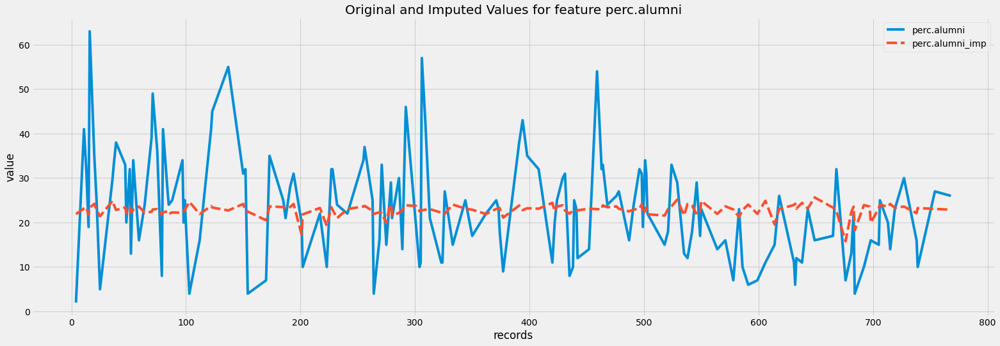

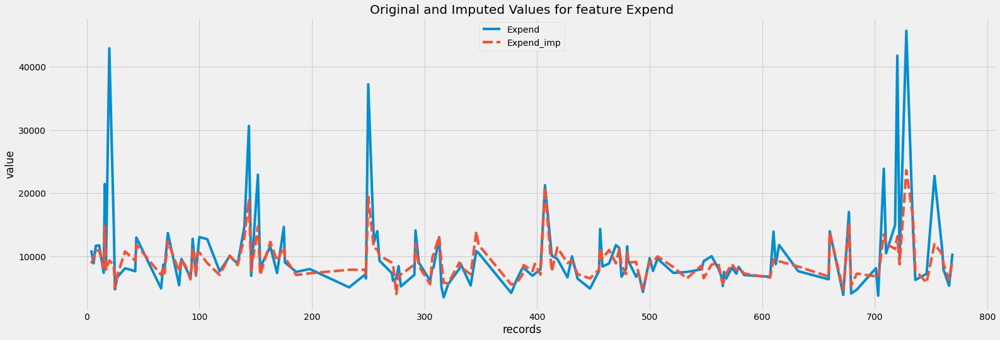

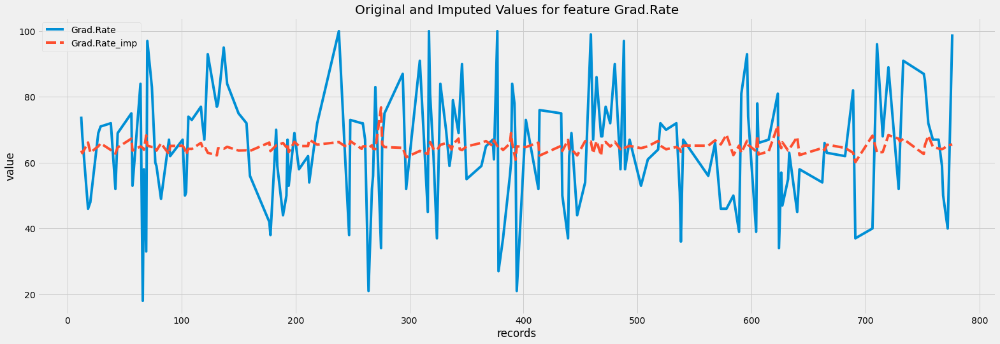

In [ ]:
#line graph of 100 first values of each col
for x in all_col_names:
  temp_df = getdf(combined_df,x)
  plotlinegraph(temp_df,x)

In [ ]:
###function to get bar plot
##percentage of imputed values within some error window

def getFeatureDataBarPlot(df):
  within_err = []
  error_allowed = 5
  all_err = []
  for col in all_col_names:
    temp_df = getdf(df,col)
    col_imp = col + '_imp'
    error_allowed = temp_df[col].std()/2 #/np.sqrt(len(temp_df[col]))
    all_err.append(error_allowed)

    x = temp_df[col] - temp_df[col_imp] 
    lst = x.to_list()
    count = len([i for i in lst if abs(i) < error_allowed]) 
    ans = count*100/len(temp_df[col])
    within_err.append(round(ans,2))

  print(within_err)

  ###bar plot code
  y_pos = np.arange(len(all_col_names))
  
  ax = plt.figure(figsize=(12, 8))
  plt.barh(y_pos, within_err, align='center', alpha=0.5)
  for index, value in enumerate(within_err):
    plt.text(value, index, str(value) + '%'+ '(+/-' + str(round(abs(all_err[index]),2)) +')' , verticalalignment='center')
  plt.yticks(y_pos, all_col_names)
  plt.xlabel('percentage')
  plt.ylabel('features')
  plt.title('Values within error threshold')
  plt.show()

[80.74, 94.7, 94.74, 87.97, 68.42, 51.57, 88.89, 86.96, 46.15, 35.03, 40.58, 50.96, 57.06, 52.38, 47.74, 36.13, 90.0, 41.52]


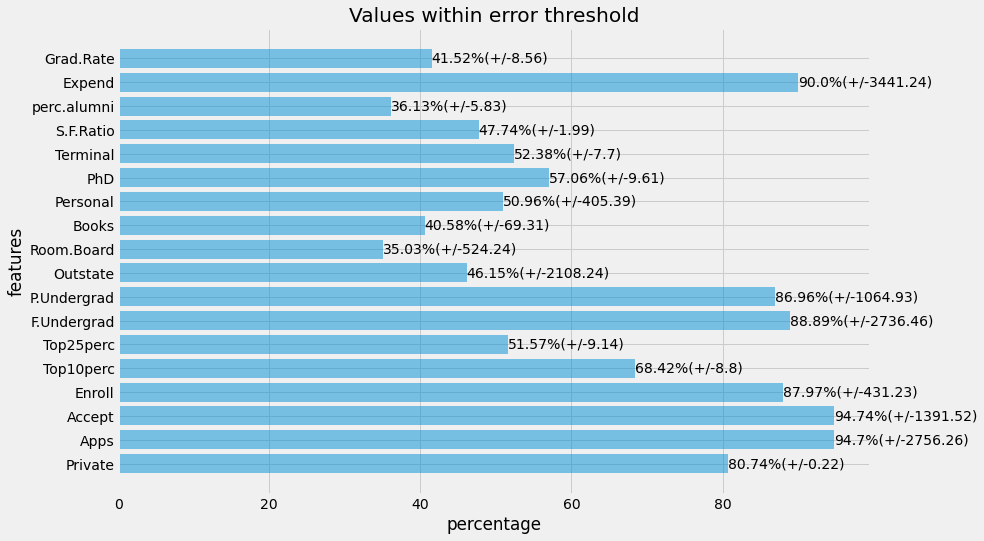

In [ ]:
getFeatureDataBarPlot(combined_df)

In [ ]:
def getslope(df, col):
  regr = linear_model.LinearRegression()
  X = df.index.values.reshape(-1,1)
  y = df[col].values.reshape(-1,1)
  regr.fit(X, y)
  return regr.coef_[0], regr.intercept_

In [ ]:
###function to plot scatter plus linear of original + imputed
def plotscatterLR(df,cl):
  cl_imp = cl + '_imp'
  ax = plt.figure(figsize=(24, 8))
  p1 = sns.regplot(x=df.index,y=[df[cl]],data=df, fit_reg=True, label='original',ci=68) 
  p2 = sns.regplot(x=df.index,y=[df[cl_imp]],data=df, fit_reg=True, label='imputed',ci=68) 

  slope1, intercept1 = getslope(df, cl)
  slope2, intercept2 = getslope(df, cl_imp)

  plt.grid(color='grey', linestyle='-', linewidth=0.3)
  plt.xlabel('records')
  plt.ylabel('value')
 
  props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
  textstr = 'slope = '+ str(slope1) +', intercept = '+str(intercept1)+'\n' + 'slope = '+ str(slope2) +', intercept = '+str(intercept2)
# place a text box in upper left in axes coords
  ax.text(0.08, 0.97, textstr, fontsize=15,verticalalignment='top', bbox=props,transform=p1.transAxes)

  plt.legend(loc='upper left')
  plt.title(cl)
  plt.show()

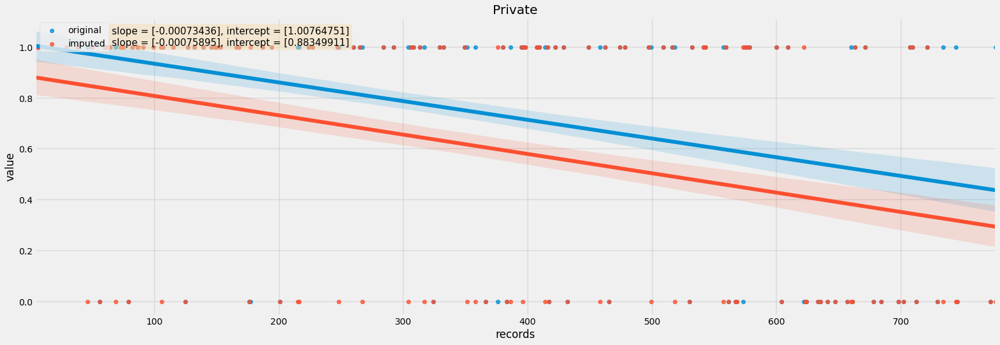

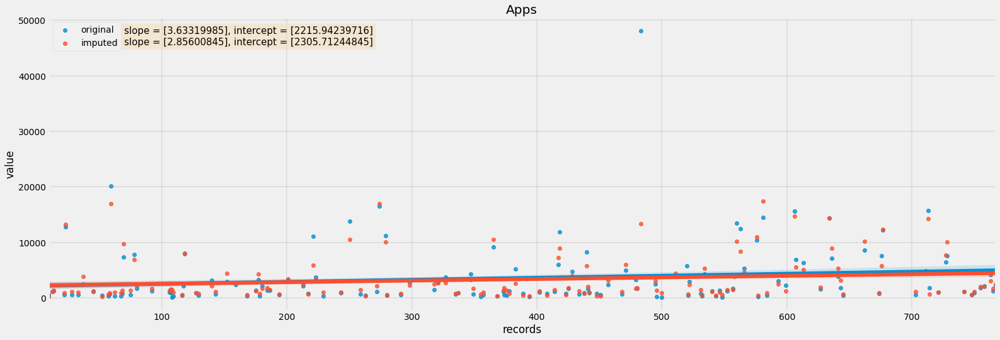

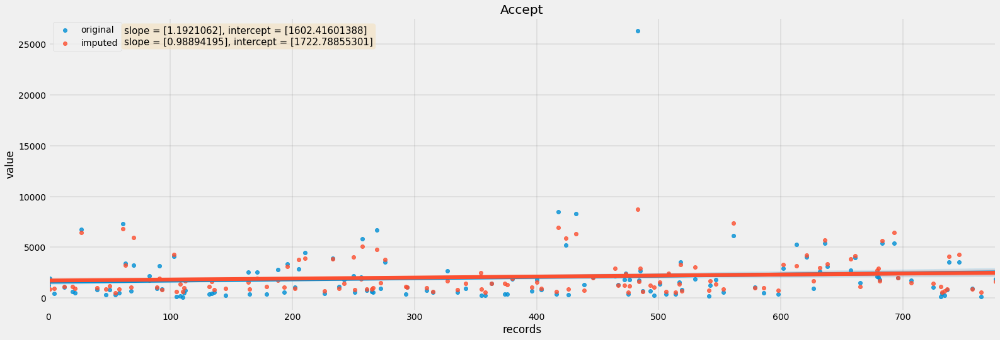

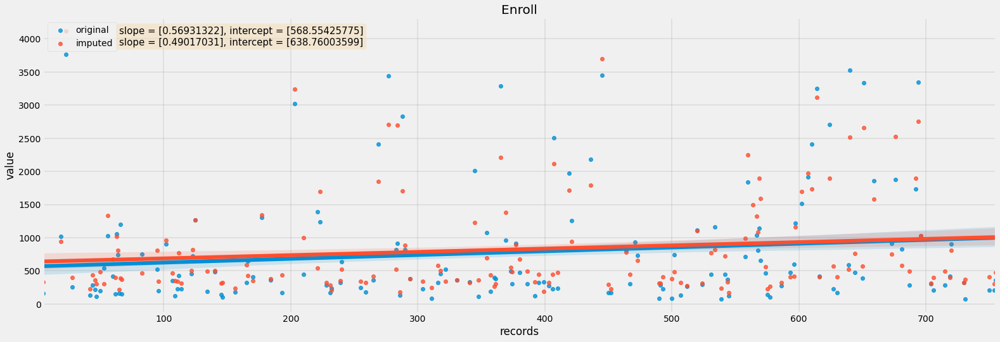

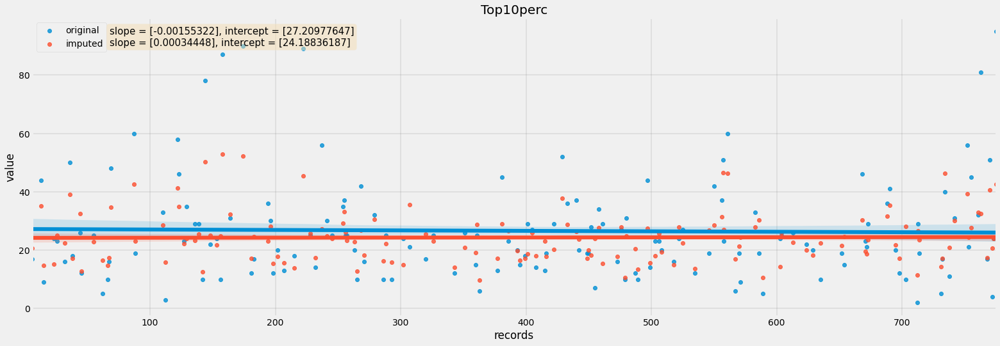

...

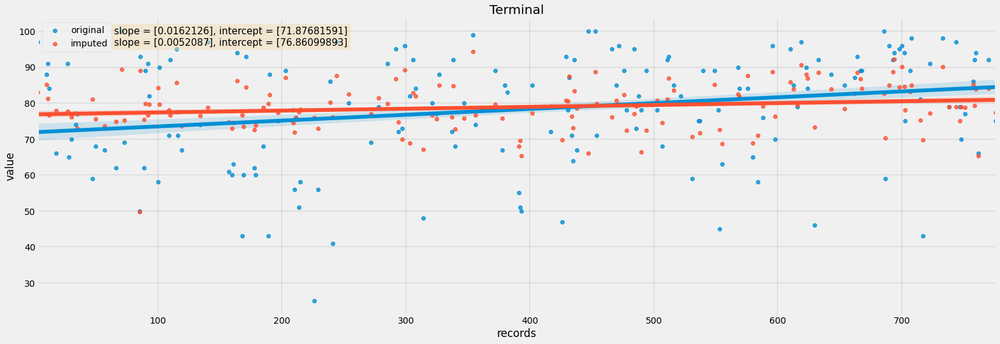

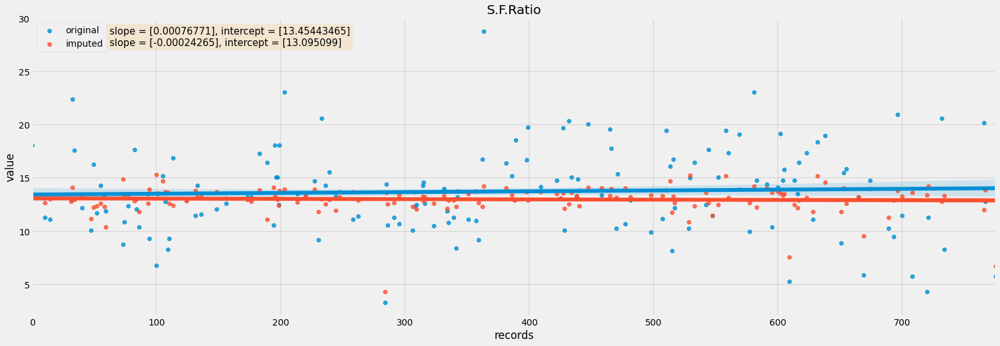

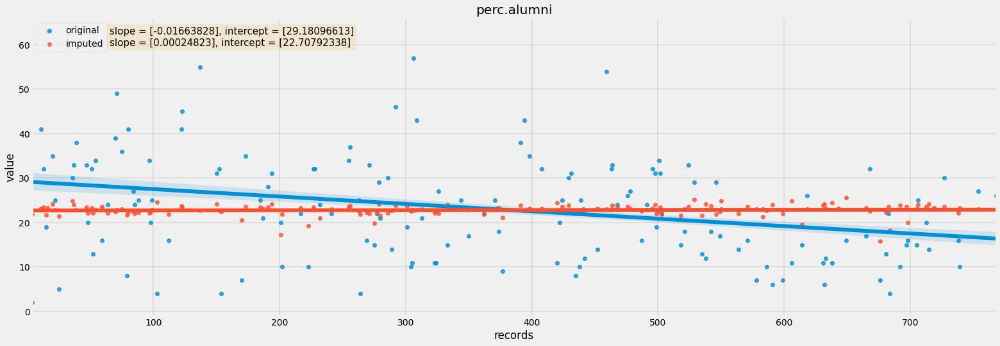

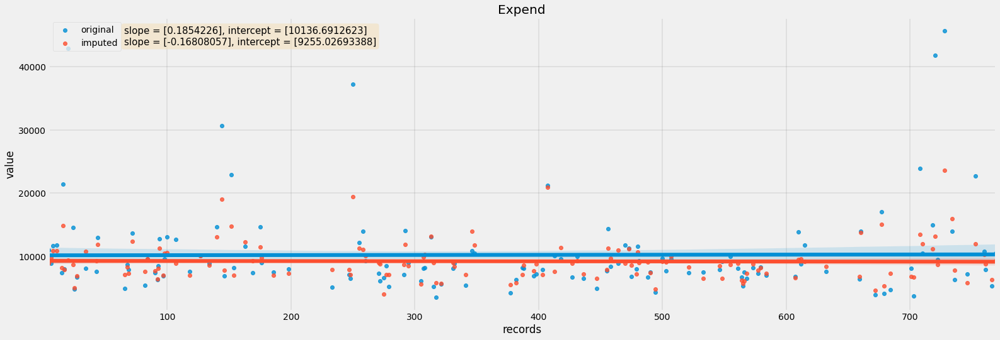

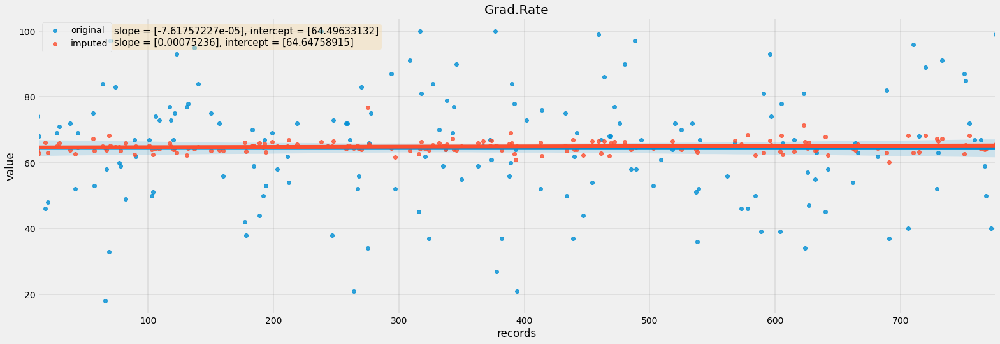

In [ ]:
for x in all_col_names:
  temp_df = getdf(combined_df,x)
  plotscatterLR(temp_df,x)

In [ ]:
####everything for spam dataset
dataset = 'spam'
filename = dataset + '/' + dataset +'.csv'

original_df = pd.read_csv(filename)
all_col_names = original_df.columns.to_list()

mis_col_names = [i+'_mis' for i in all_col_names]
imp_col_names = [i+'_imp' for i in all_col_names]

miss_filename = dataset +'/missing.csv'
imp_filename = dataset +'/imputed.csv'
miss_df = pd.read_csv(miss_filename,names= mis_col_names)
imp_df = pd.read_csv(imp_filename,names= imp_col_names)

df4 = original_df.join(miss_df)
combined_df = df4.join(imp_df)

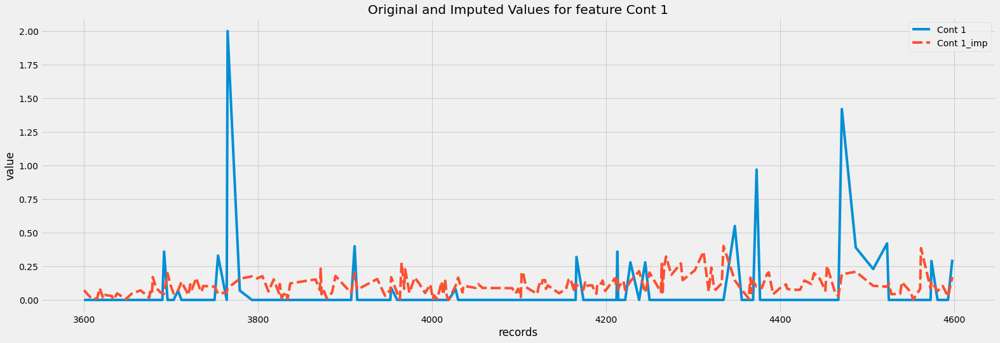

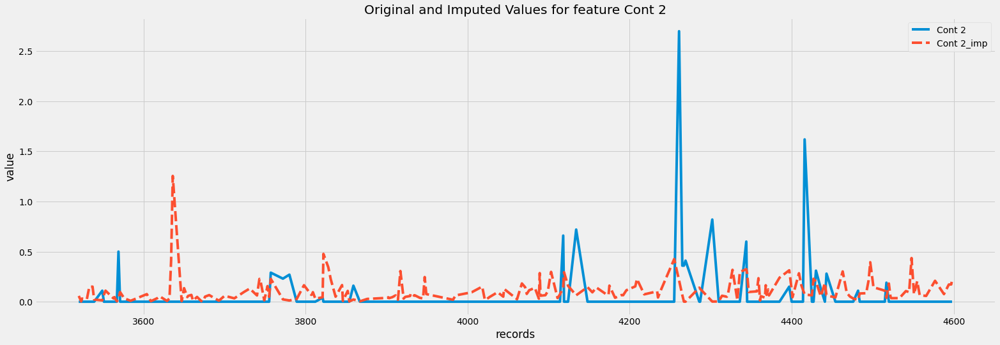

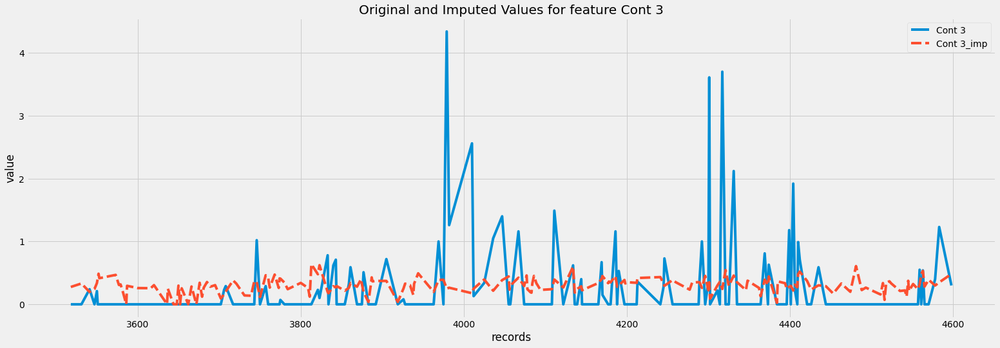

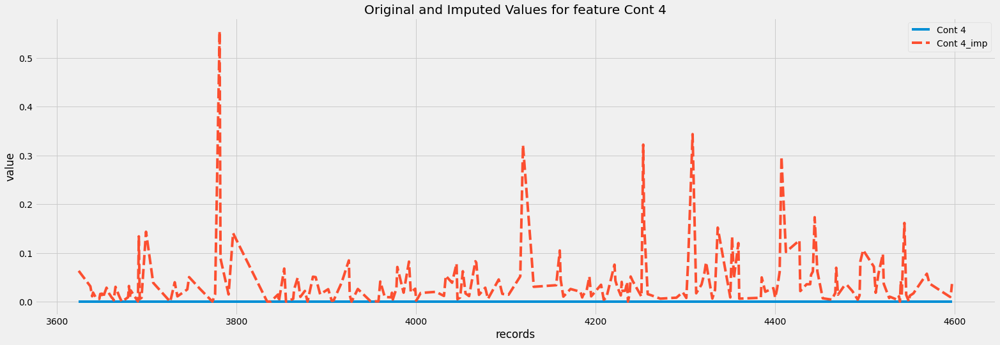

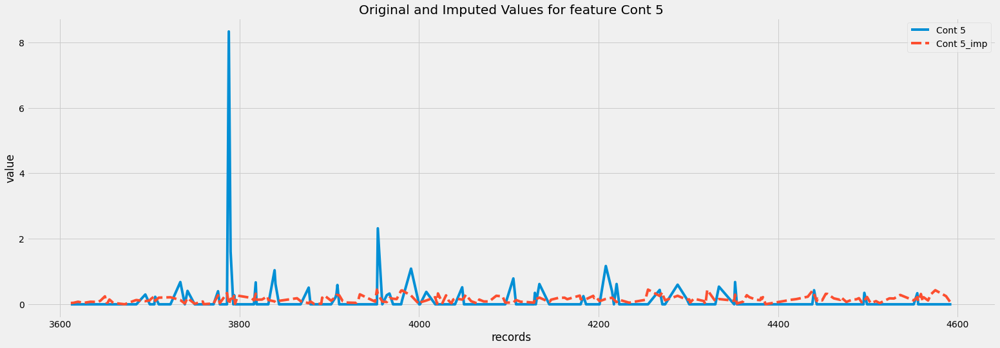

...

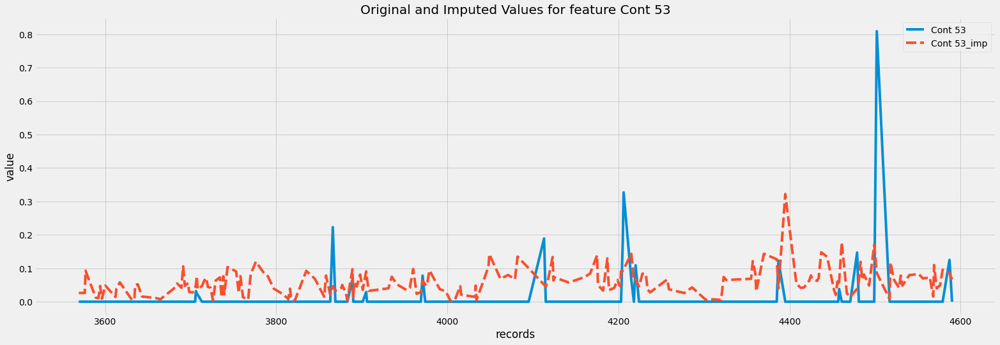

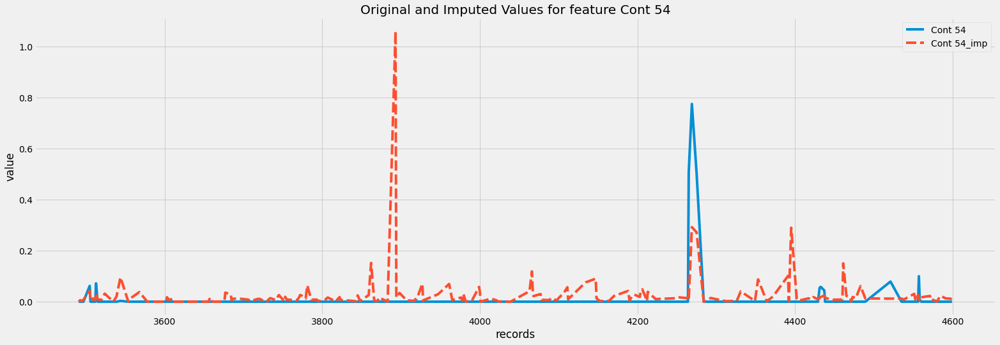

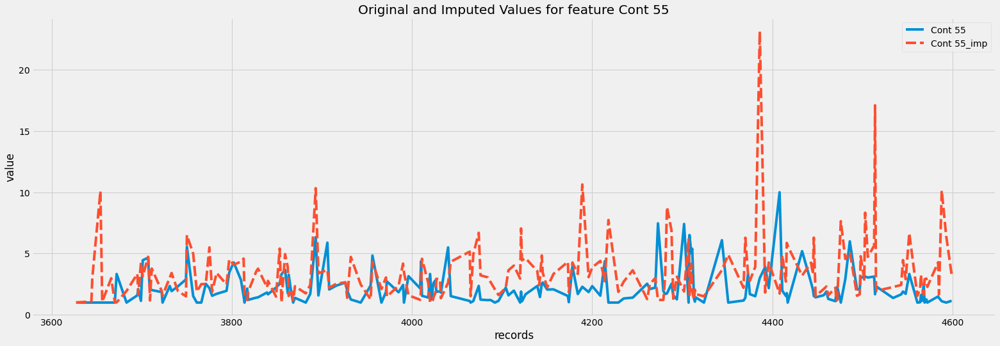

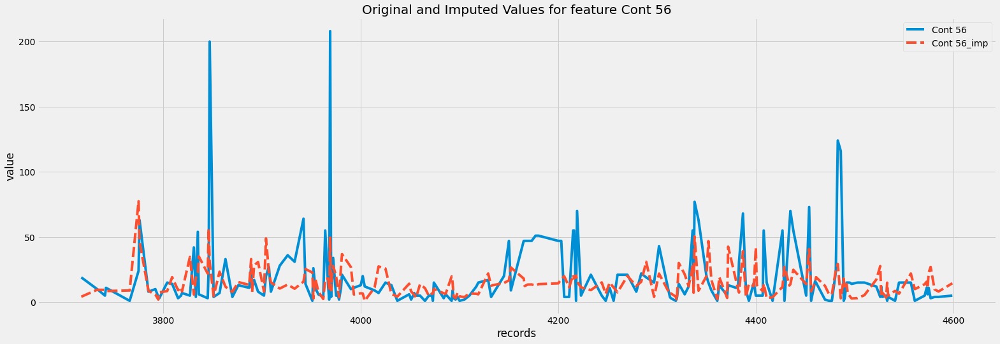

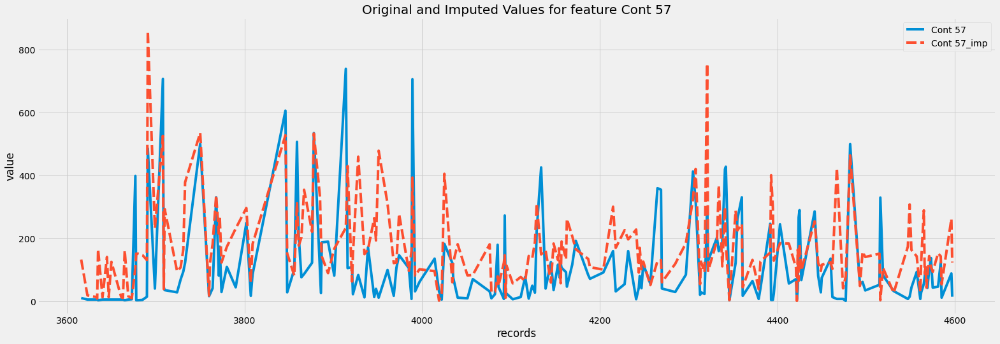

In [ ]:
#line graph of 100 first values of each col
for x in all_col_names:
  temp_df = getdf(combined_df,x)
  plotlinegraph(temp_df,x)

[65.7, 94.89, 42.94, 99.78, 75.54, 77.6, 85.57, 83.79, 86.14, 64.87, 86.1, 42.87, 82.77, 94.57, 94.41, 87.56, 83.66, 81.25, 41.2, 92.18, 59.17, 96.86, 86.89, 86.15, 88.04, 85.94, 93.9, 91.18, 95.74, 90.33, 93.93, 97.29, 93.01, 97.77, 94.61, 84.32, 80.27, 95.03, 89.41, 92.89, 95.72, 88.9, 91.77, 86.33, 78.4, 90.54, 98.72, 92.1, 94.67, 70.73, 87.61, 89.98, 84.94, 95.96, 96.58, 88.46, 76.6]


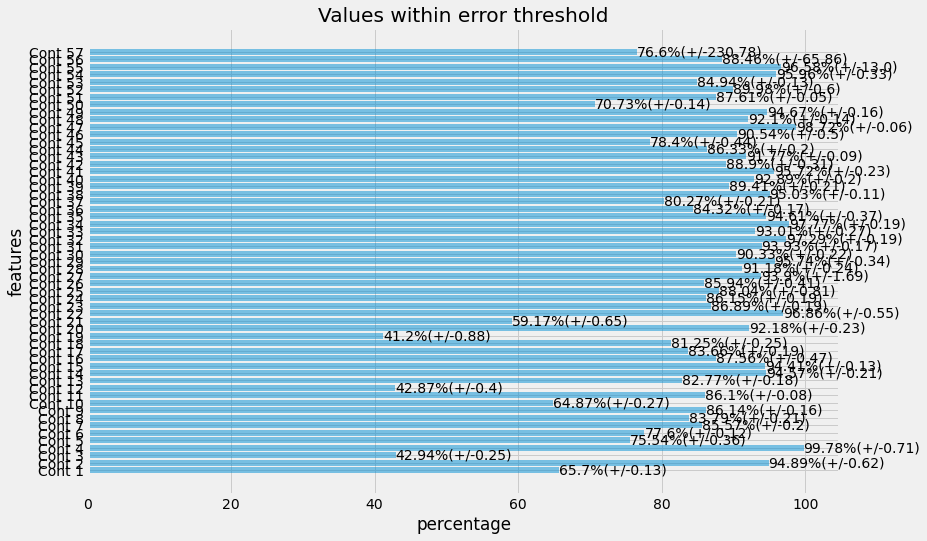

In [ ]:
getFeatureDataBarPlot(combined_df)

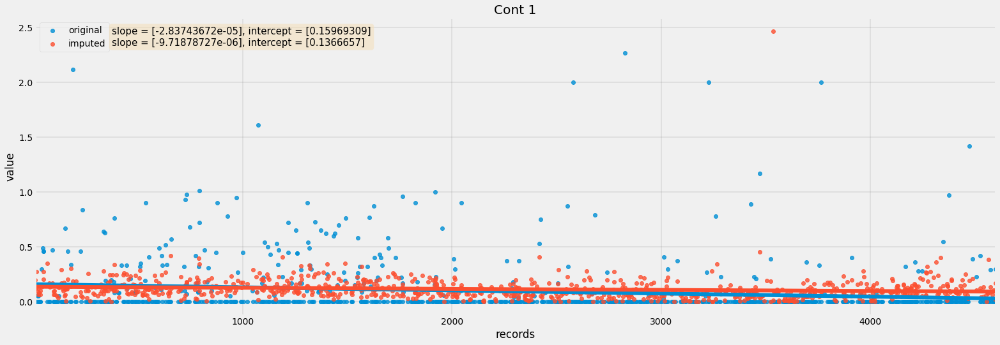

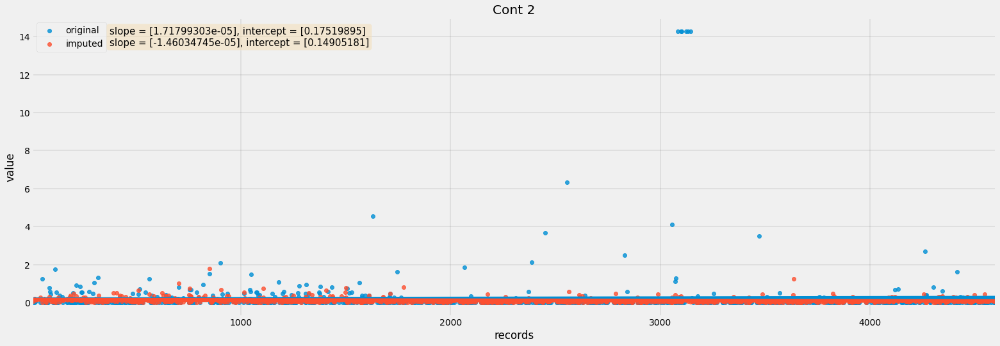

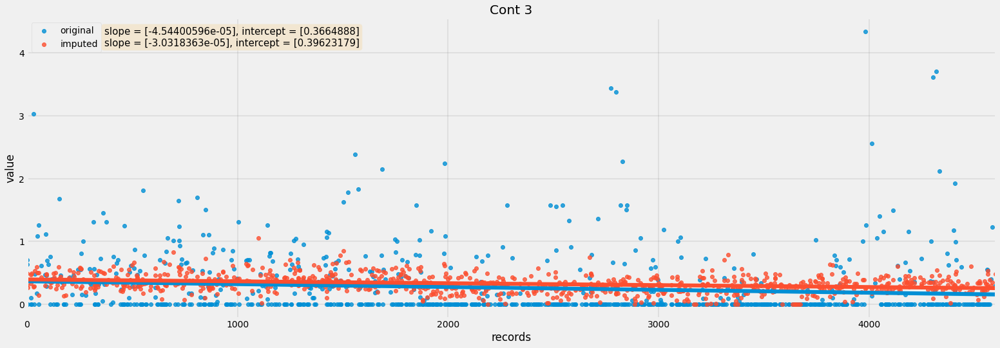

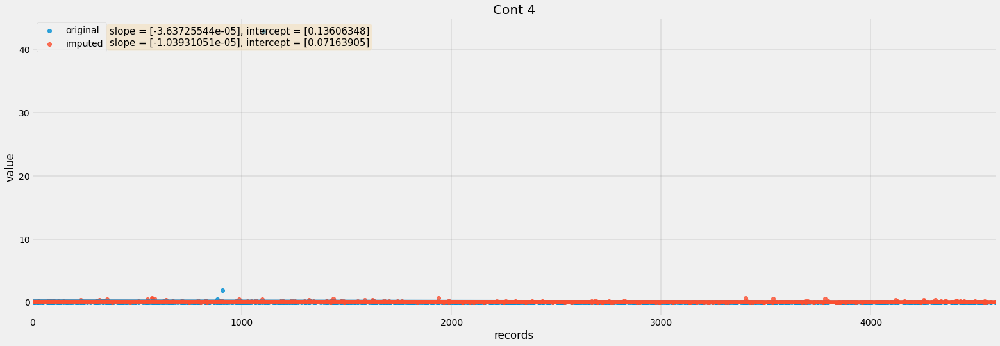

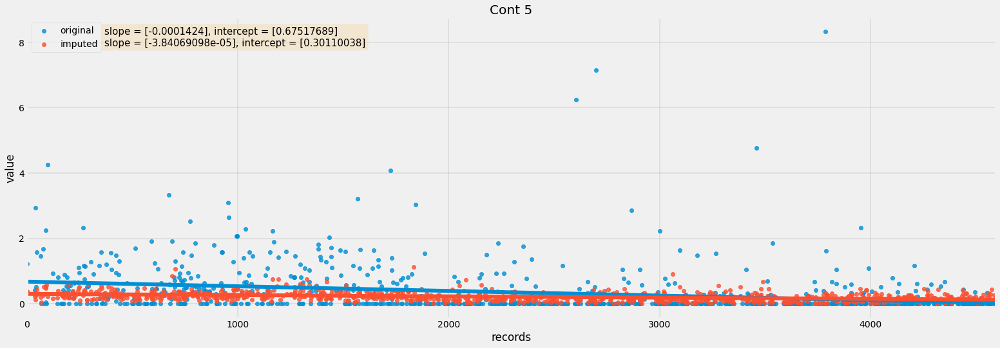

...

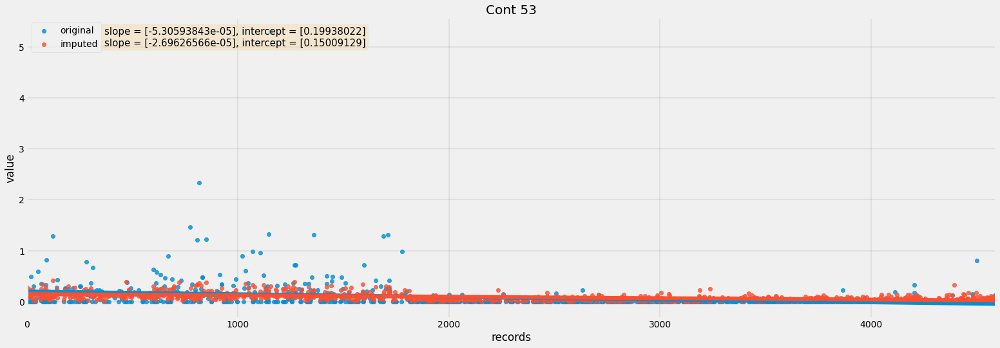

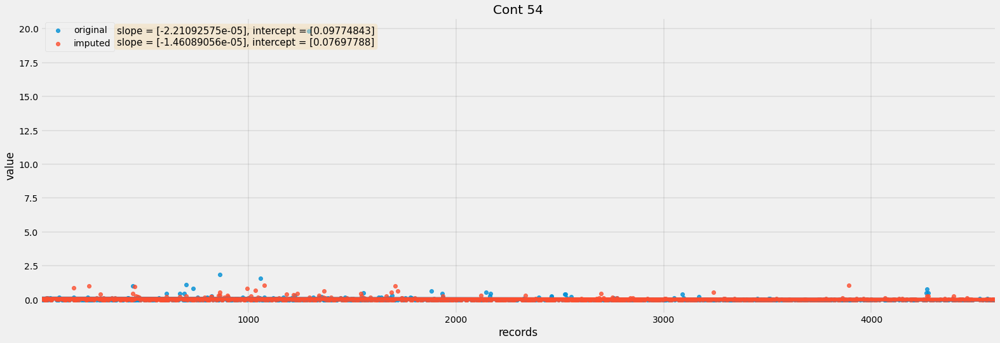

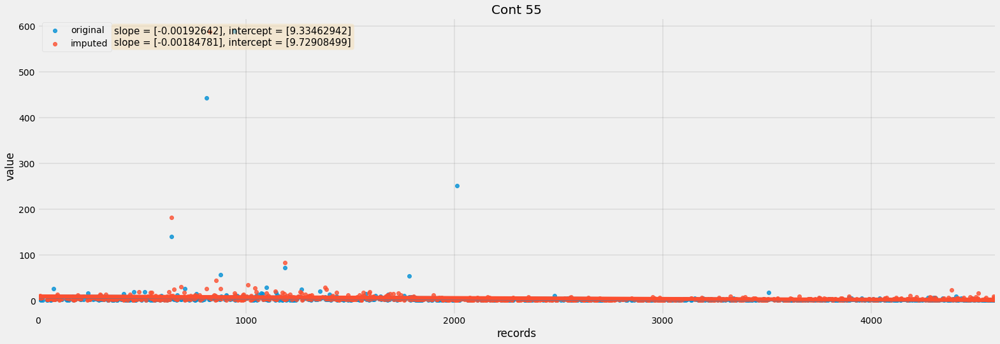

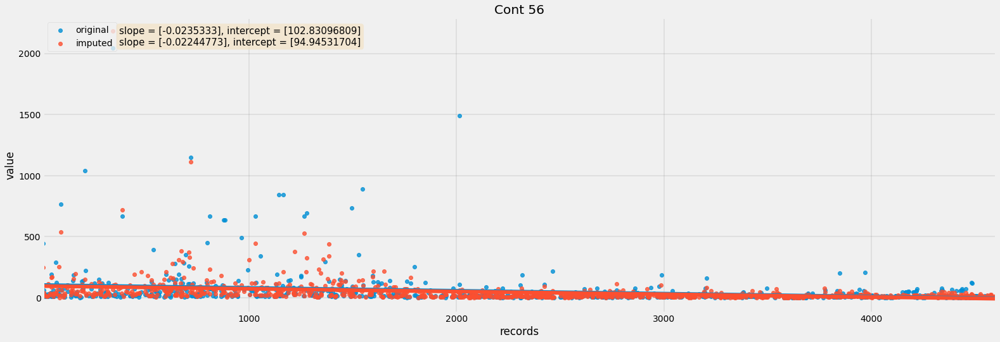

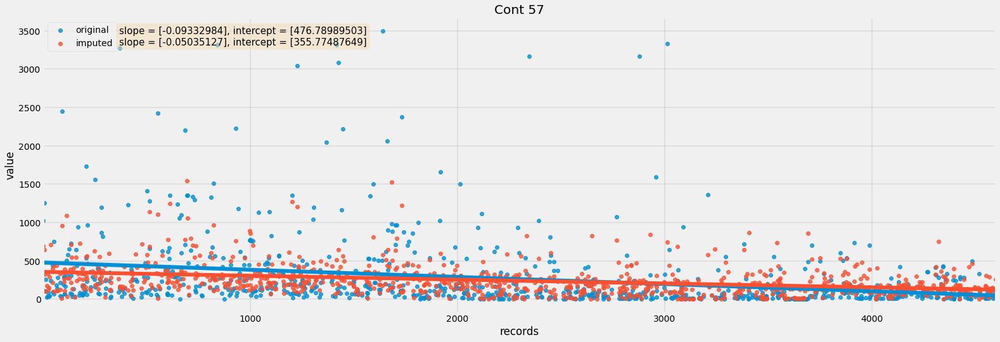

In [ ]:
for x in all_col_names:
  temp_df = getdf(combined_df,x)
  plotscatterLR(temp_df,x)

In [ ]:
####everything for letter dataset
dataset = 'letter'
filename = dataset + '/' + dataset +'.csv'

original_df = pd.read_csv(filename)
all_col_names = original_df.columns.to_list()

mis_col_names = [i+'_mis' for i in all_col_names]
imp_col_names = [i+'_imp' for i in all_col_names]

miss_filename = dataset +'/missing.csv'
imp_filename = dataset +'/imputed.csv'
miss_df = pd.read_csv(miss_filename,names= mis_col_names)
imp_df = pd.read_csv(imp_filename,names= imp_col_names)

df4 = original_df.join(miss_df)
combined_df = df4.join(imp_df)


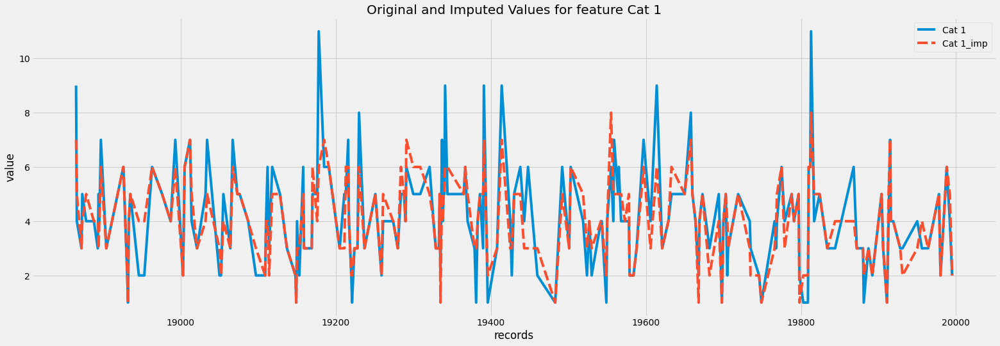

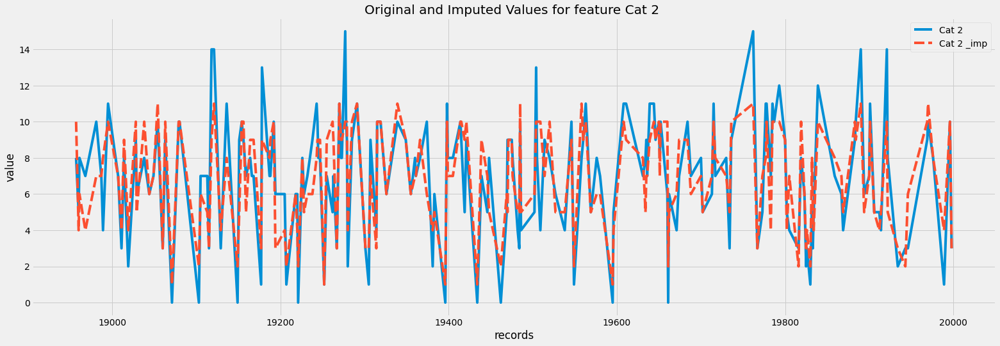

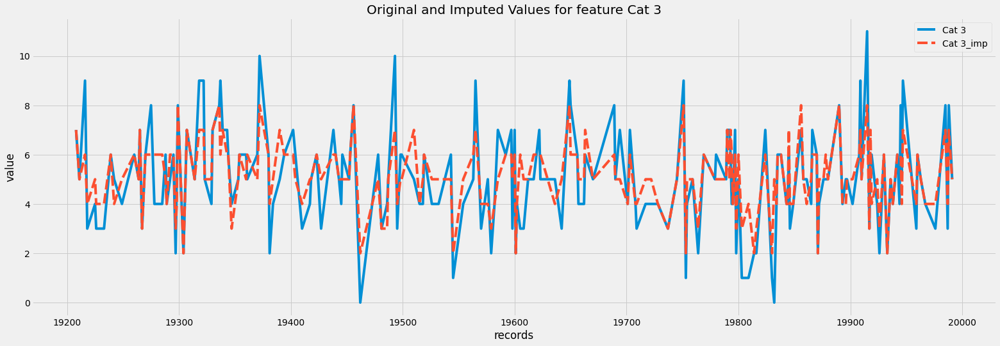

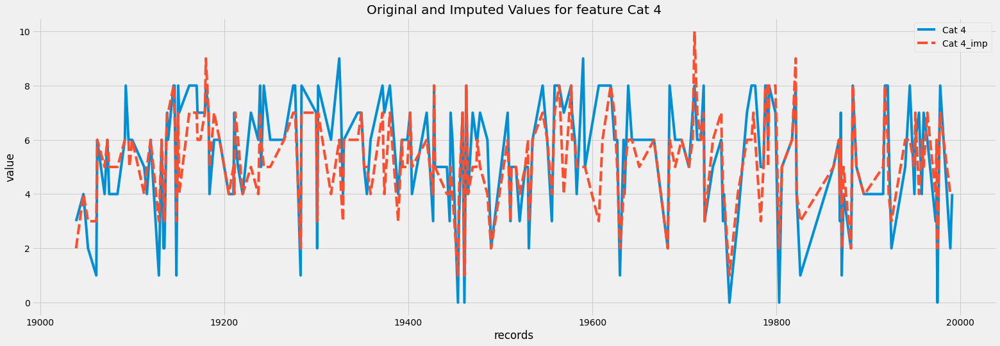

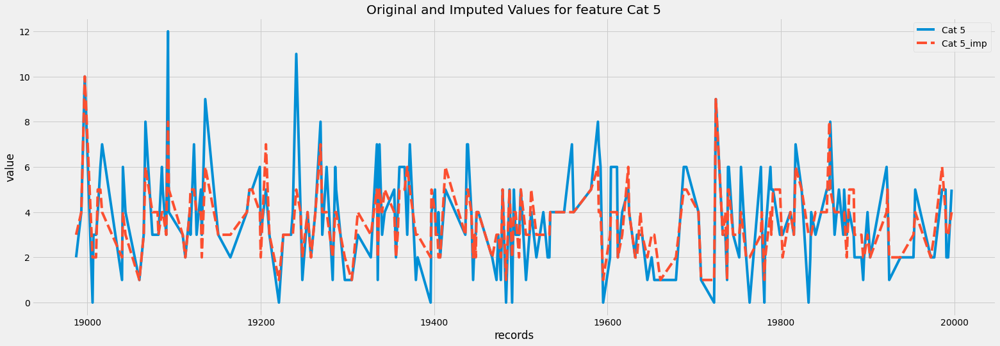

...

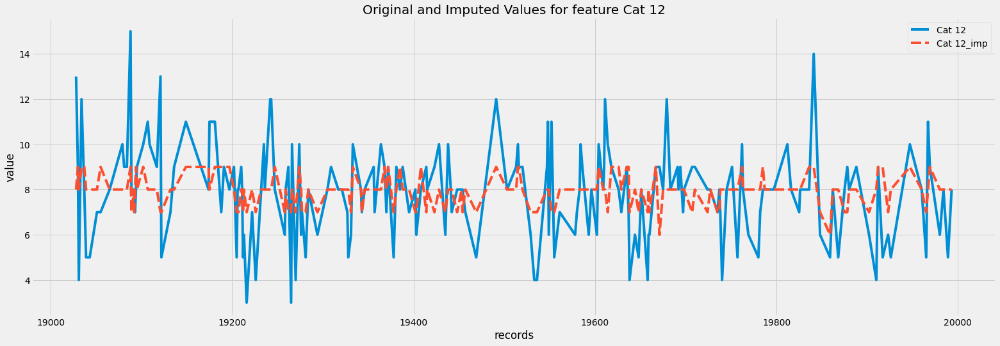

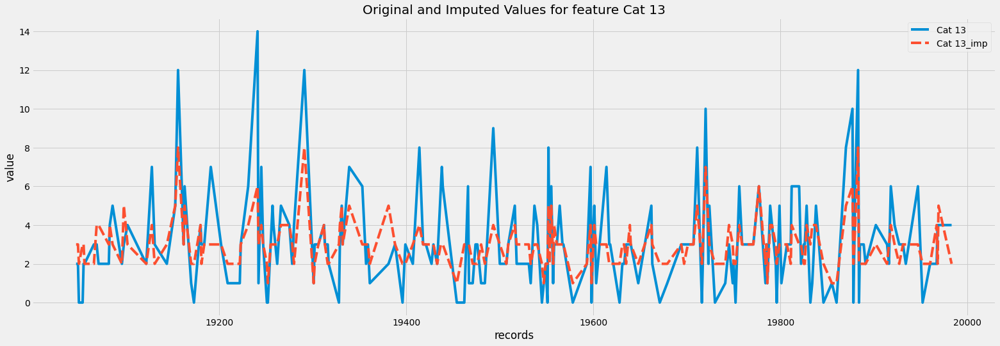

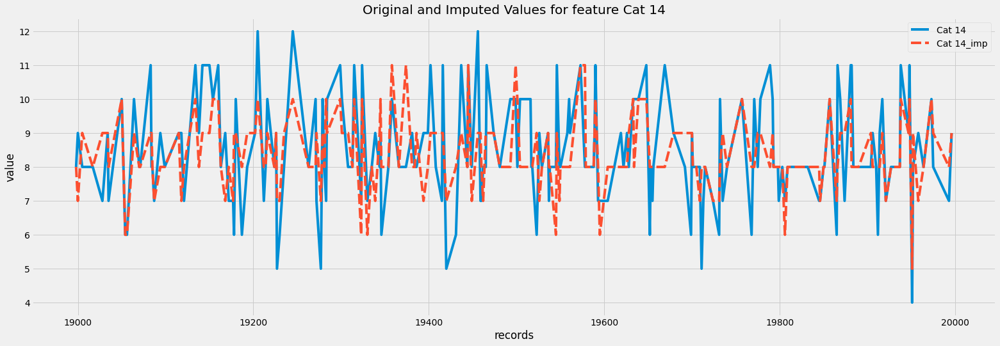

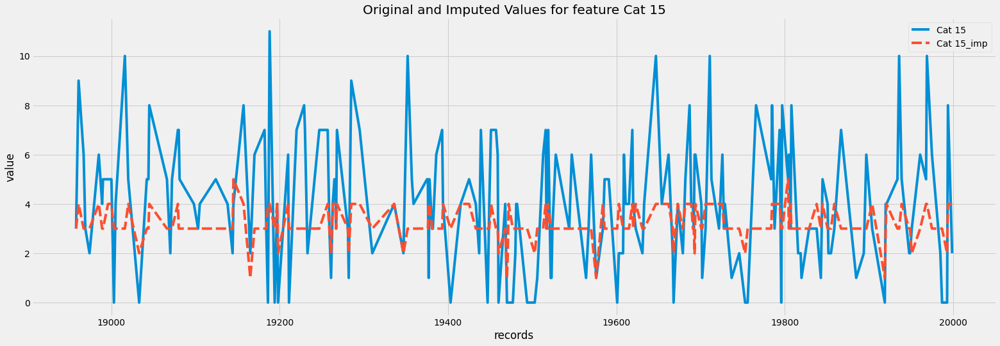

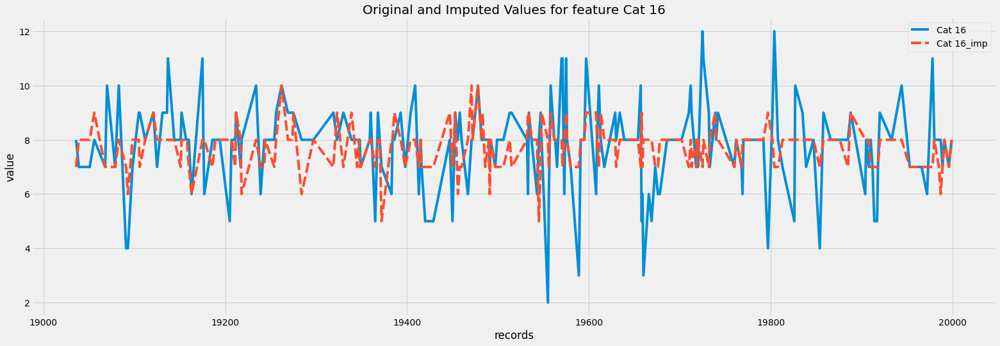

In [ ]:
for x in all_col_names:
  temp_df = getdf(combined_df,x)
  plotlinegraph(temp_df,x)

[43.8, 62.22, 39.64, 79.08, 80.75, 70.52, 69.36, 46.34, 48.22, 45.54, 64.04, 63.9, 67.46, 39.13, 48.45, 33.59]


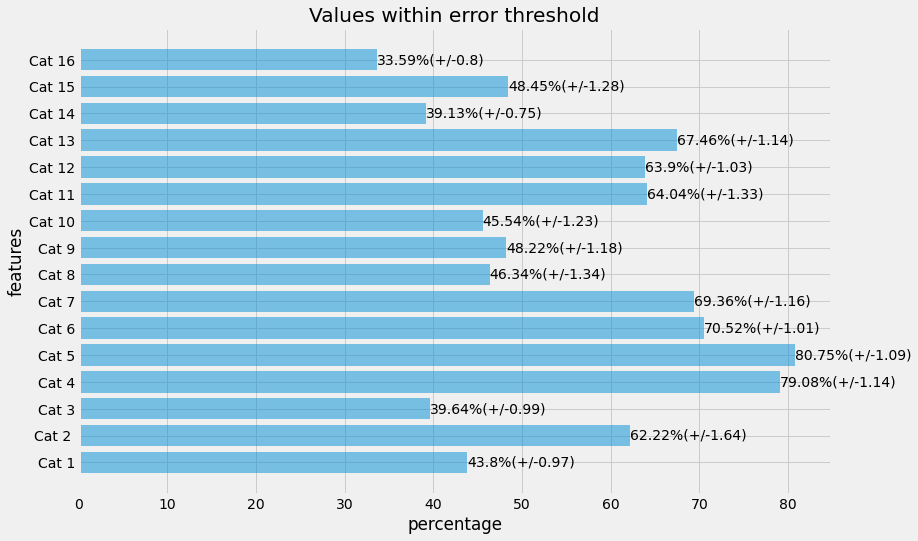

In [ ]:
getFeatureDataBarPlot(combined_df)

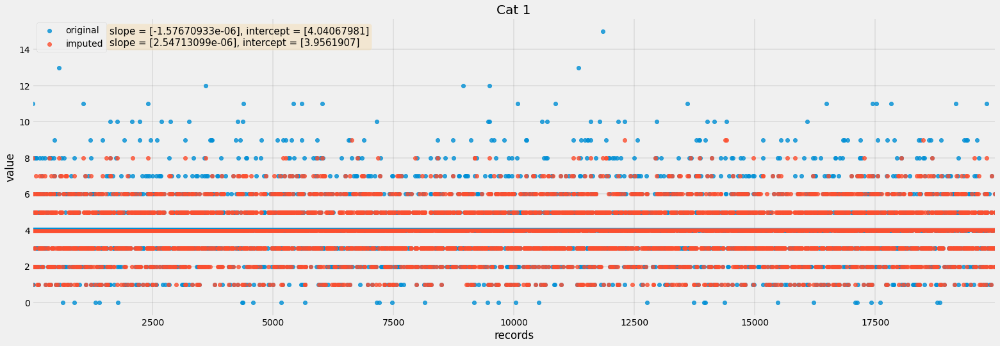

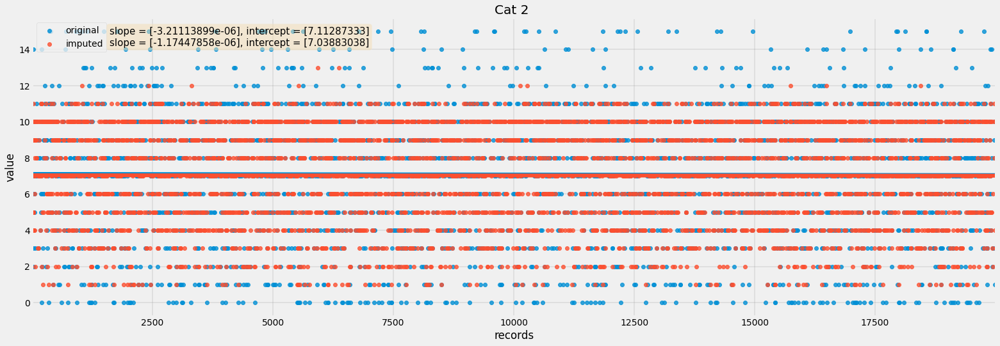

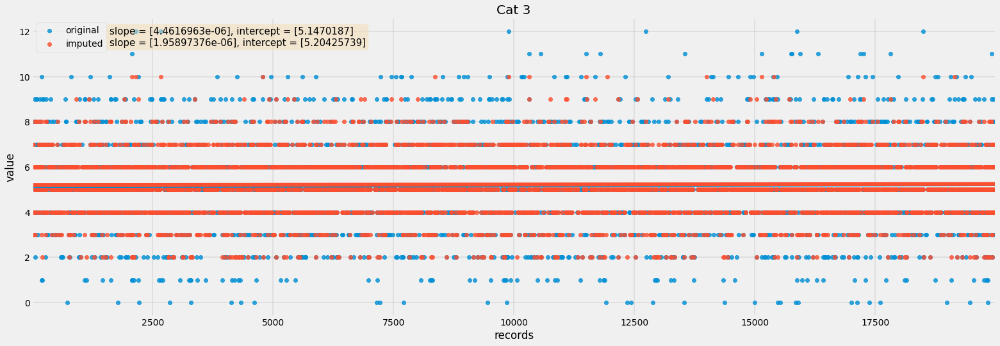

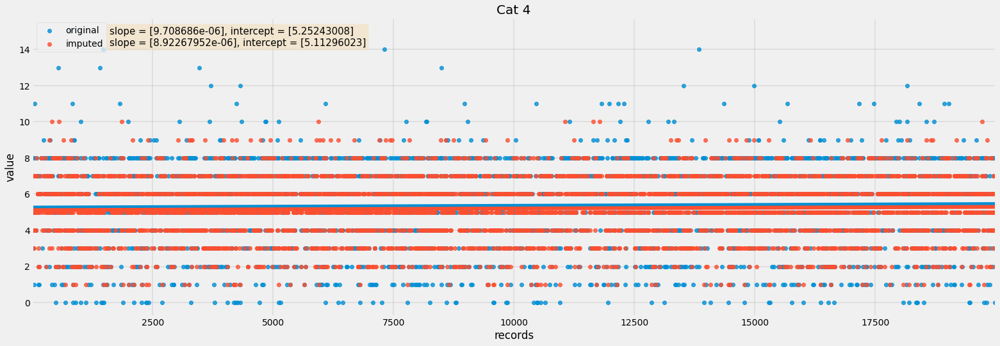

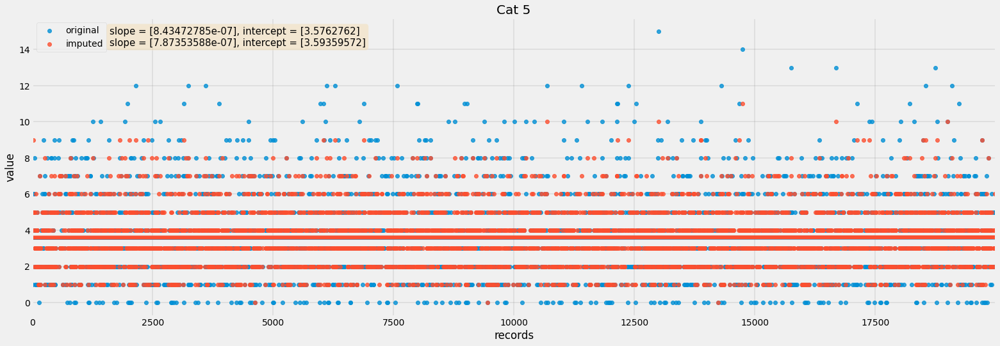

...

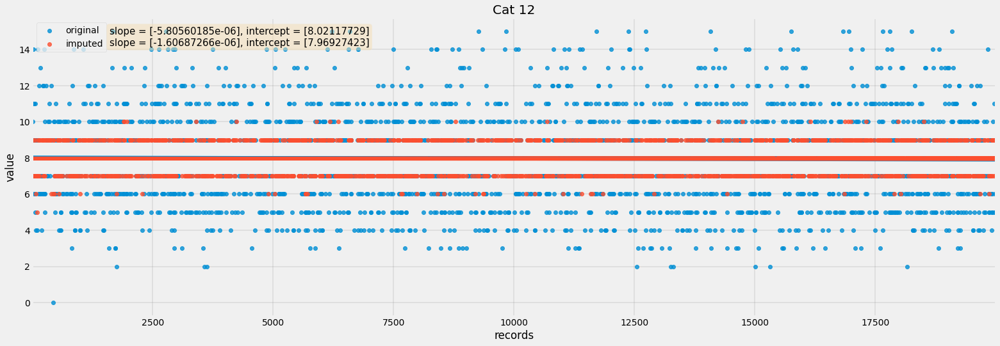

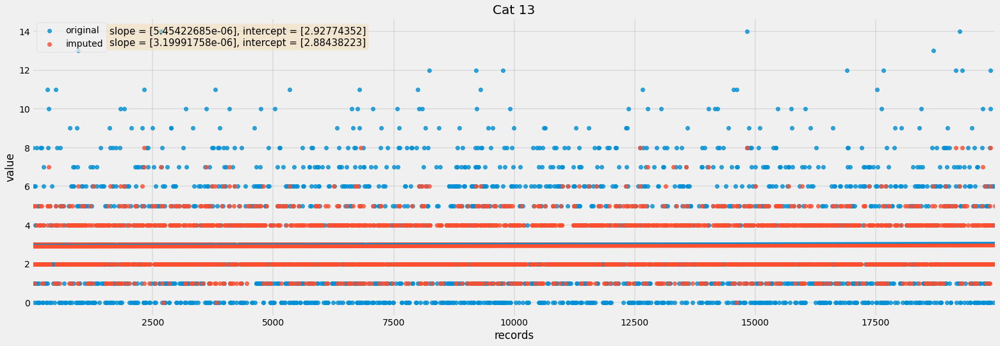

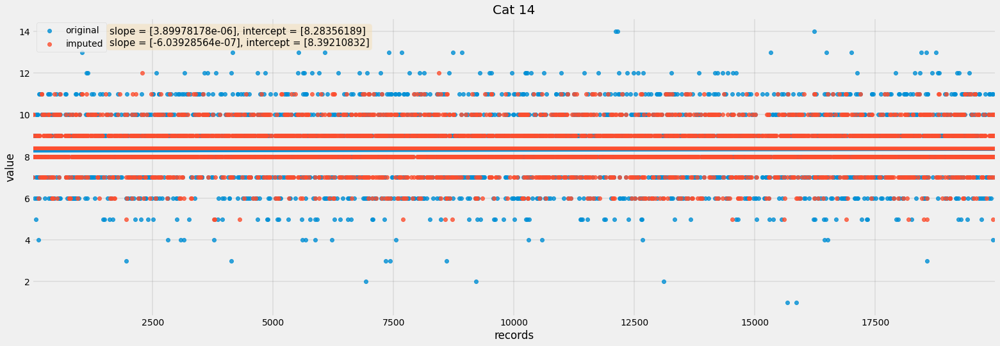

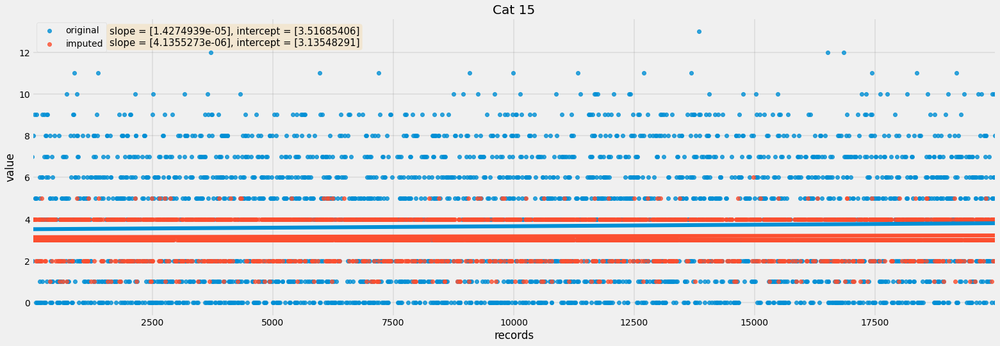

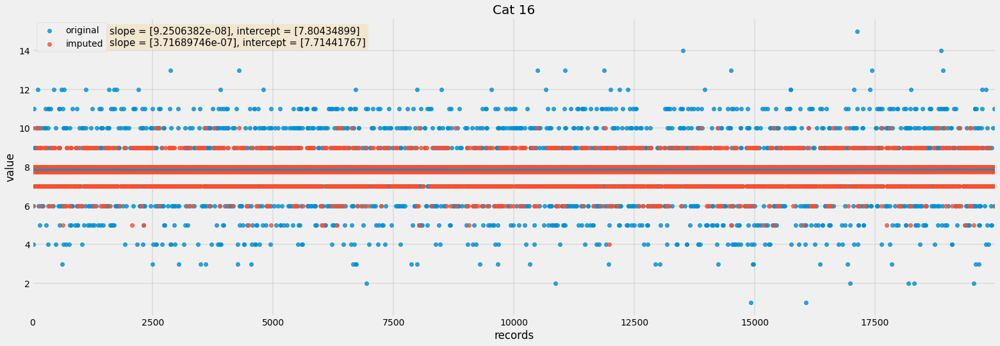

In [ ]:
for x in all_col_names:
  temp_df = getdf(combined_df,x)
  plotscatterLR(temp_df,x)

In [ ]:
###to run the same code for other dataset, just change the college.csv with other csv along with imputed and missing csv
#dframe creation
dataset = 'college'
filename = dataset + '/' + dataset +'.csv'

original_df = pd.read_csv(filename)
all_col_names = original_df.columns.to_list()

mis_col_names = [i+'_mis' for i in all_col_names]
imp_col_names = [i+'_imp' for i in all_col_names]

miss_filename = dataset +'/missing.csv'
imp_filename = dataset +'/imputed.csv'
miss_df = pd.read_csv(miss_filename,names= mis_col_names)
imp_df = pd.read_csv(imp_filename,names= imp_col_names)

df4 = original_df.join(miss_df)
combined_df = df4.join(imp_df)


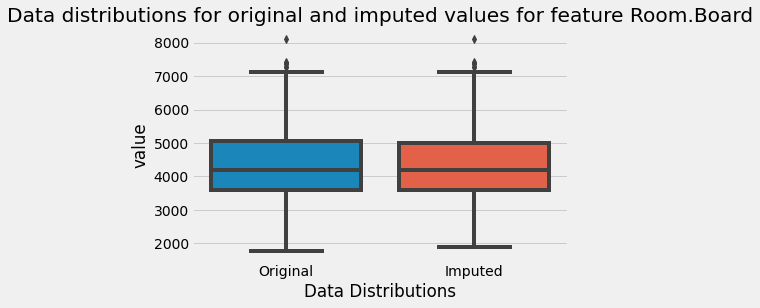

In [ ]:
#plt.rcParams["figure.figsize"] = (10,5)
cdf = pd.DataFrame(data = {"Original": original_df['Room.Board'],
                          "Imputed": miss_df['Room.Board_mis']
                         })
sns.boxplot(x="variable", y="value", data=pd.melt(cdf))
plt.xlabel('Data Distributions')
plt.title('Data distributions for original and imputed values for feature Room.Board')
plt.show()

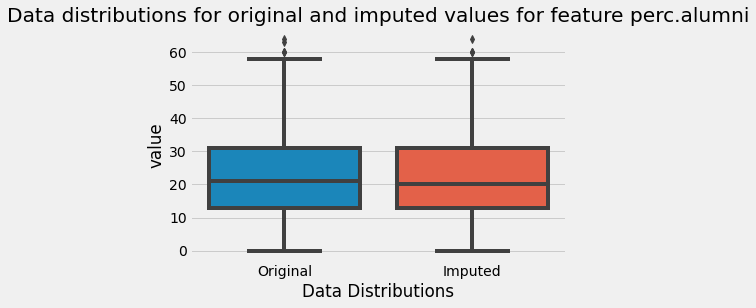

In [ ]:
cdf = pd.DataFrame(data = {"Original": original_df['perc.alumni'],
                          "Imputed": miss_df['perc.alumni_mis']
                         })
sns.boxplot(x="variable", y="value", data=pd.melt(cdf))
plt.xlabel('Data Distributions')
plt.title('Data distributions for original and imputed values for feature perc.alumni')
plt.show()

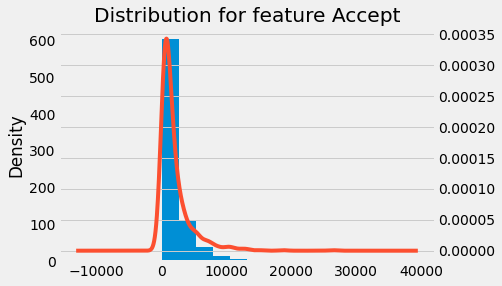

In [ ]:
plt.title('Distribution for feature Accept')
ax = original_df['Accept'].plot(kind='hist')
original_df['Accept'].plot(kind='kde', ax=ax, secondary_y=True)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


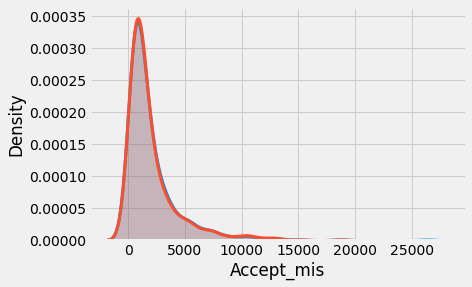

In [ ]:
#plt.title('Distribution of original and imputed values for feature Accept')
sns.distplot(original_df['Accept'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'Accept')
sns.distplot(miss_df['Accept_mis'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'Accept_mis')

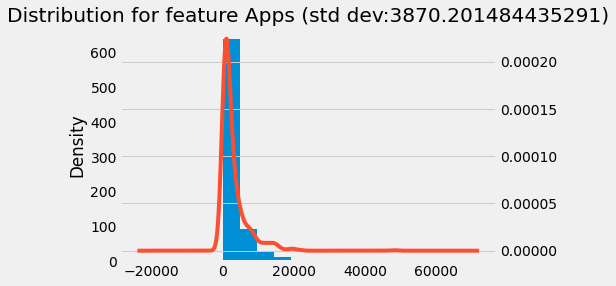

In [ ]:
std = original_df['Apps'].std()
plt.title('Distribution for feature Apps' + ' (std dev:' + str(std) +')')
ax = original_df['Apps'].plot(kind='hist')
original_df['Apps'].plot(kind='kde', ax=ax, secondary_y=True)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


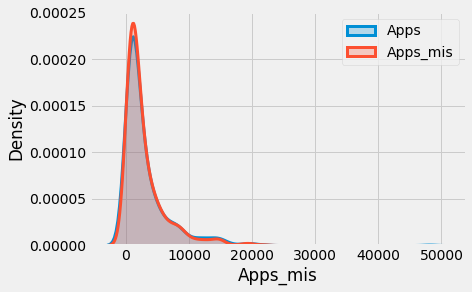

In [ ]:
#plt.title('Density plot of original and imputed values for feature Apps')
plt.xlabel('Value')
sns.distplot(original_df['Apps'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'Apps')
sns.distplot(miss_df['Apps_mis'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'Apps_mis')
plt.legend()

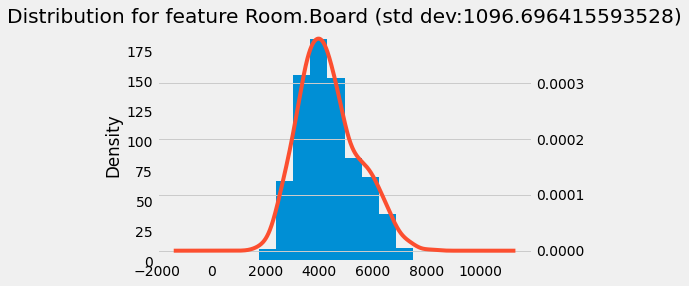

In [ ]:
std = original_df['Room.Board'].std()
plt.title('Distribution for feature Room.Board' + ' (std dev:' + str(std) +')')
ax = original_df['Room.Board'].plot(kind='hist')
original_df['Room.Board'].plot(kind='kde', ax=ax, secondary_y=True)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


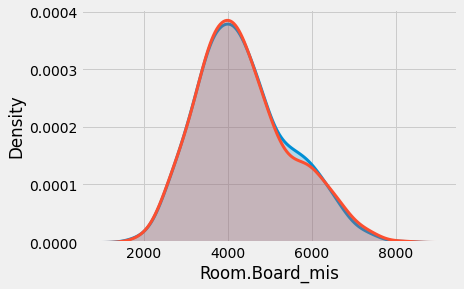

In [ ]:
sns.distplot(original_df['Room.Board'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'Room.Board')
sns.distplot(miss_df['Room.Board_mis'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'Room.Board_mis')

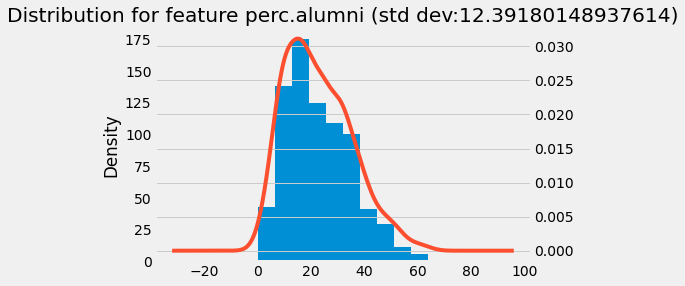

In [ ]:
std = original_df['perc.alumni'].std()
plt.title('Distribution for feature perc.alumni' + ' (std dev:' + str(std) +')')
ax = original_df['perc.alumni'].plot(kind='hist')
original_df['perc.alumni'].plot(kind='kde', ax=ax, secondary_y=True)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


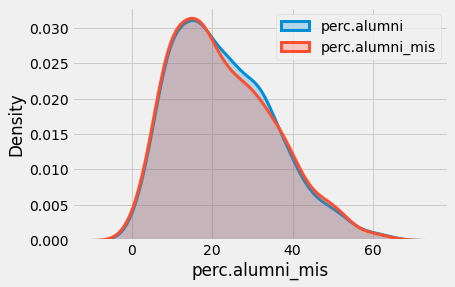

In [ ]:
#plt.title('Density plot of original and imputed values for feature perc.alumni')
plt.xlabel('Value')
sns.distplot(original_df['perc.alumni'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'perc.alumni')
sns.distplot(miss_df['perc.alumni_mis'], hist = False, kde = True,
                 kde_kws = {'shade': True, 'linewidth': 3}, 
                  label = 'perc.alumni_mis')
plt.legend()

In [ ]:
def plot_biscatter(col1,col2):
  col1imp = col1 + '_imp'
  col2imp = col2 + '_imp'

  ax1 = combined_df.plot(kind='scatter', x=col1imp, y=col2imp, color='b', s=3)
  ax2 = combined_df.plot(kind='scatter', x=col1, y=col2, color='g', ax=ax1, s=3)
  ax2.legend([ "imputed","original"])    
  print(ax2 == ax)

In [ ]:
#best imputed in college dataset according to linear regress (scatter plot original vs imputed)
plot_biscatter('Accept','Grad.Rate')
plot_biscatter('Accept','Room.Board')
plot_biscatter('Room.Board','Grad.Rate')

In [ ]:
#worst imputed in college dataset according to linear regress (scatter plot original vs imputed)
plot_biscatter('Private','Top10perc')
plot_biscatter('perc.alumni','Top10perc')
plot_biscatter('Private','perc.alumni')

In [ ]:
#best imputed in spam dataset according to dual line graphs
plot_biscatter('Cont 56','Cont 57')
plot_biscatter('Cont 56','Cont 40')
plot_biscatter('Cont 40','Cont 57')

In [ ]:
#worst test imputed in spam dataset according to dual line graphs
plot_biscatter('Cont 44','Cont 45')
plot_biscatter('Cont 45','Cont 37')
plot_biscatter('Cont 44','Cont 37')

In [ ]:
###to run the same code for other dataset, just give the dataset name in function argument
def plot_error_bars(name, rcparamX, rcparamY):
  #dframe creation
  dataset = name
  filename = dataset + '/' + dataset +'.csv'

  original_df = pd.read_csv(filename)
  all_col_names = original_df.columns.to_list()

  miss_filename = dataset +'/missing.csv'
  imp_filename = dataset +'/imputed.csv'
  miss_df = pd.read_csv(miss_filename,names= all_col_names)
  imp_df = pd.read_csv(imp_filename,names= all_col_names)

  #add original and imputed values in the new type column in the df. concat imputed and original df and aggregate
  #to find out the mean, std dev and std error for each feature, both original and imputed 
  original_df['type'] = 'original'
  imp_df['type'] = 'imputed'
  concat_df = pd.concat([original_df, imp_df])
  group_df = concat_df.groupby("type").agg([np.mean, np.std, stats.sem])

  #create sem_values array with sets of original and imputed values for each feature
  sem_values = []
  for i in range(len(all_col_names) - 1):
    sem_values.append(group_df[all_col_names[i]]['sem'][0])
    sem_values.append(group_df[all_col_names[i]]['sem'][1])

  #normalization for plotting
  sem_values /= np.max(sem_values, axis=0)
  sem_values *= 100
  sem_values = sem_values.astype(int)

  plt.rcParams["figure.figsize"] = (rcparamX, rcparamY)
  plt.xlabel('Percentage Difference in Standard Error')
  plt.ylabel('Features')
  plt.title('Comparison of Standard Error in original vs imputed data')
  for i in range(len(sem_values)//2):
    plt.hlines(y = all_col_names[i], xmin = sem_values[2*i], xmax = sem_values[2*i + 1])

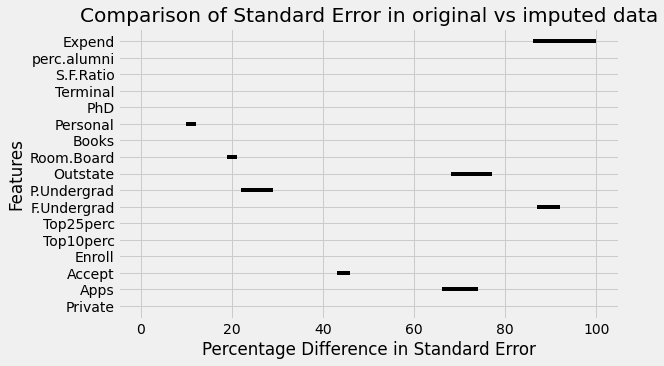

In [ ]:
plot_error_bars('college', 8, 5)

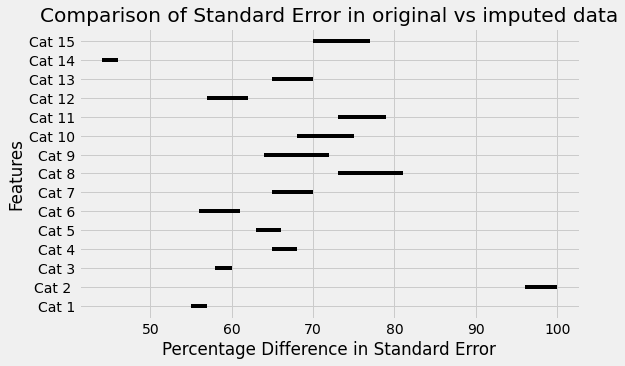

In [ ]:
plot_error_bars('letter', 8,5)

In [ ]:
def error_box_plot(name):
  dataset = name
  filename = dataset + '/' + dataset +'.csv'

  original_df = pd.read_csv(filename)
  all_col_names = original_df.columns.to_list()

  mis_col_names = [i+'_mis' for i in all_col_names]
  imp_col_names = [i+'_imp' for i in all_col_names]

  miss_filename = dataset +'/missing.csv'
  imp_filename = dataset +'/imputed.csv'
  miss_df = pd.read_csv(miss_filename,names= mis_col_names)
  imp_df = pd.read_csv(imp_filename,names= imp_col_names)

  df4 = original_df.join(miss_df)
  combined_df = df4.join(imp_df)

  for i in all_col_names:
    nan_df = combined_df[np.isnan(combined_df[i + '_mis'])][[i + '_imp',i]]
    nan_df['diff'] = abs(nan_df[i] - nan_df[i + '_imp'])
    sns.boxplot(x="diff", data=nan_df)
    plt.xlabel('Error Value')
    plt.title('Error distribution for feature ' + i)
    plt.show()

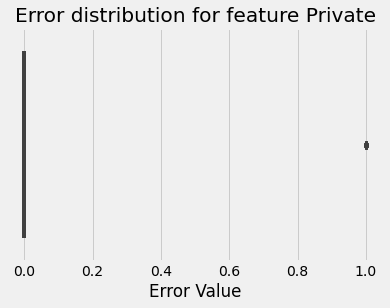

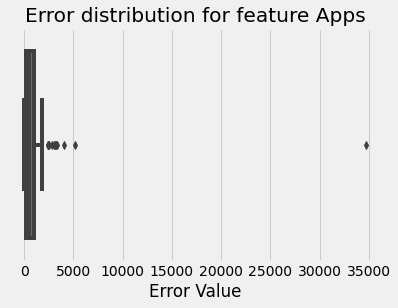

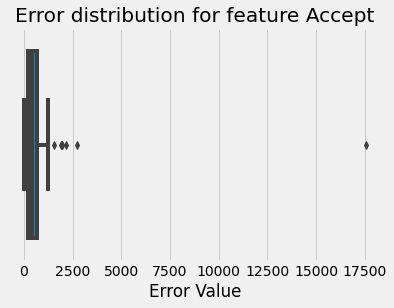

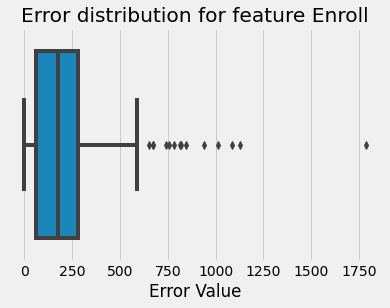

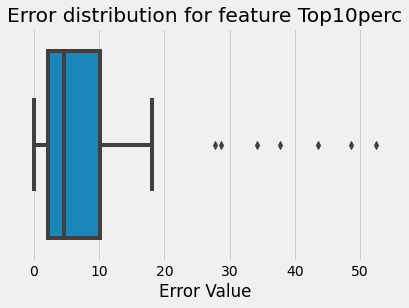

...

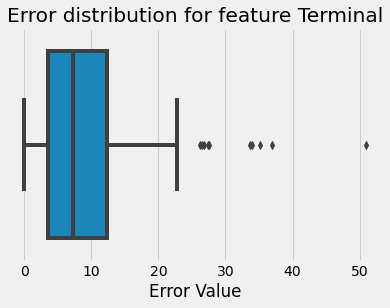

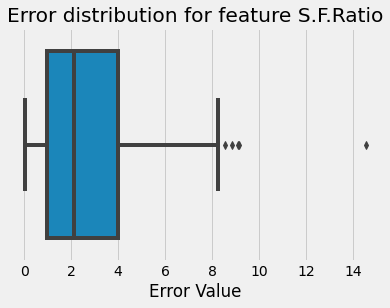

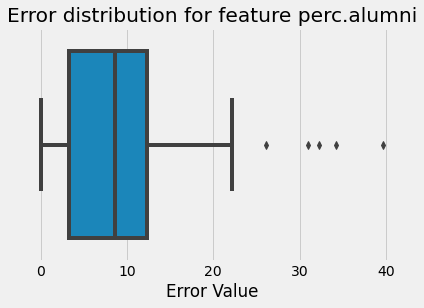

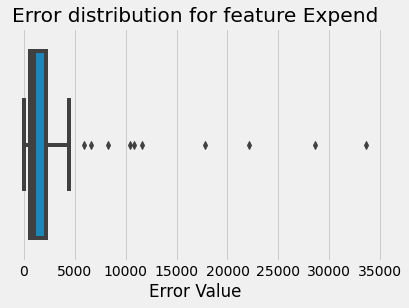

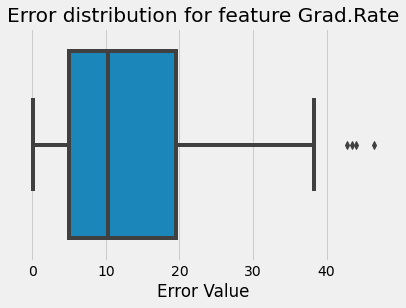

In [ ]:
error_box_plot('college')

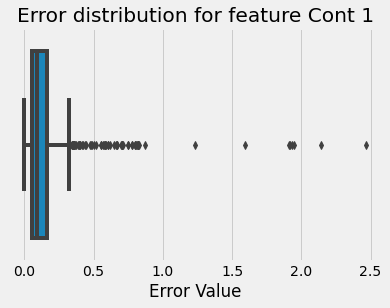

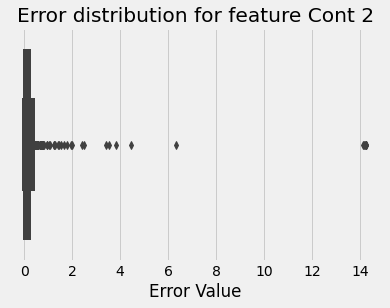

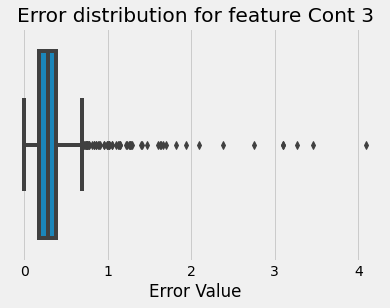

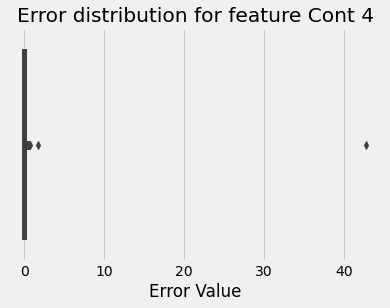

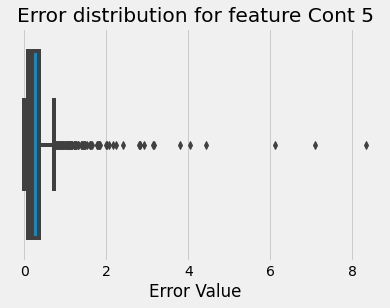

...

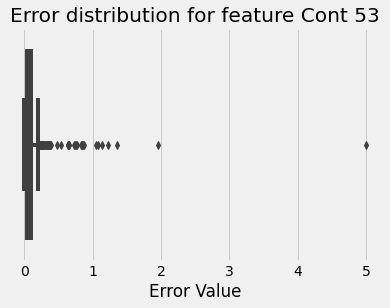

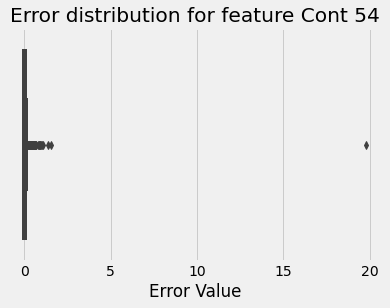

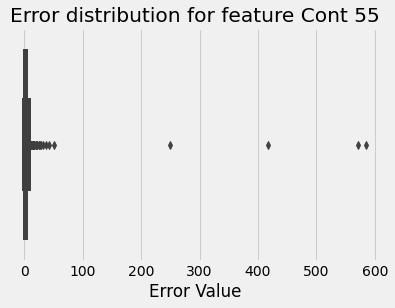

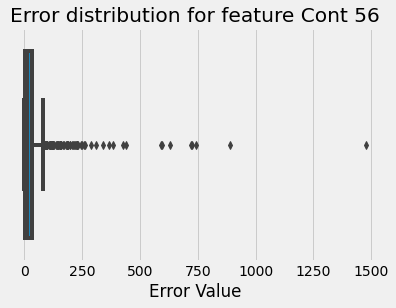

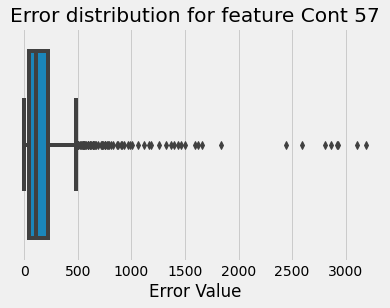

In [ ]:
error_box_plot('spam')

In [ ]:
def error_box_plot_without_outliers(name):
  dataset = name
  filename = dataset + '/' + dataset +'.csv'

  original_df = pd.read_csv(filename)
  all_col_names = original_df.columns.to_list()

  mis_col_names = [i+'_mis' for i in all_col_names]
  imp_col_names = [i+'_imp' for i in all_col_names]

  miss_filename = dataset +'/missing.csv'
  imp_filename = dataset +'/imputed.csv'
  miss_df = pd.read_csv(miss_filename,names= mis_col_names)
  imp_df = pd.read_csv(imp_filename,names= imp_col_names)

  df4 = original_df.join(miss_df)
  combined_df = df4.join(imp_df)

  for i in all_col_names:
    nan_df = combined_df[np.isnan(combined_df[i + '_mis'])][[i + '_imp',i]]
    nan_df['diff'] = abs(nan_df[i] - nan_df[i + '_imp'])
    nan_df['diff_zscore'] = stats.zscore(nan_df['diff'])
    nan_df = nan_df[nan_df['diff_zscore'] <= 3]
    sns.boxplot(x="diff", data=nan_df)
    plt.xlabel('Error values for feature ' + i)
    #plt.title('Error distribution for feature ' + i)
    plt.show()

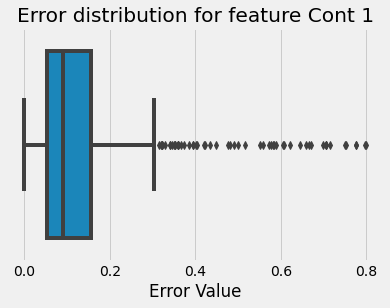

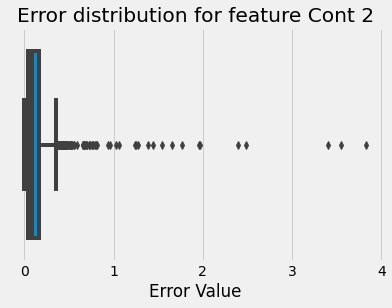

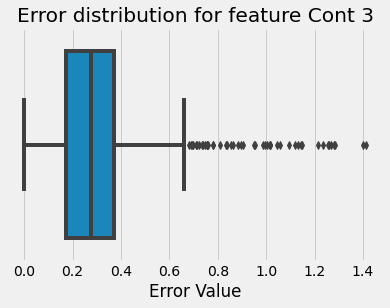

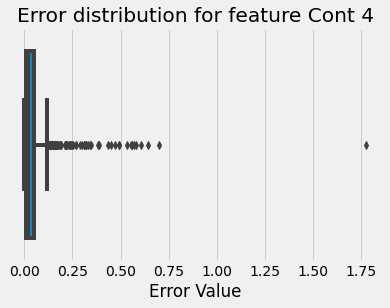

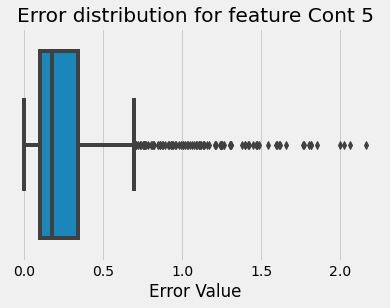

...

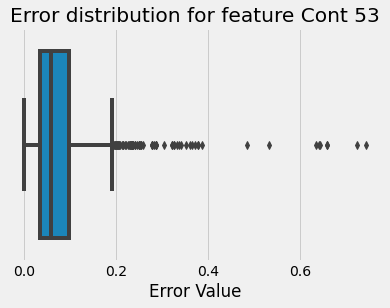

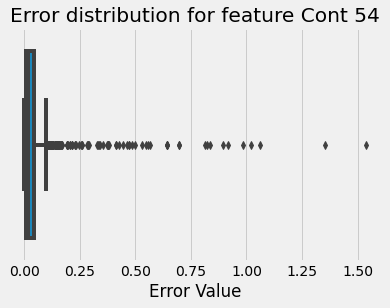

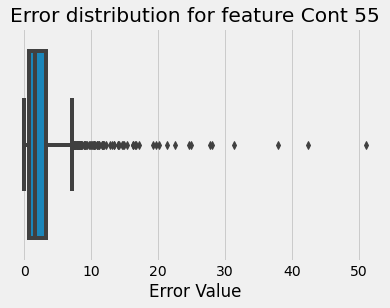

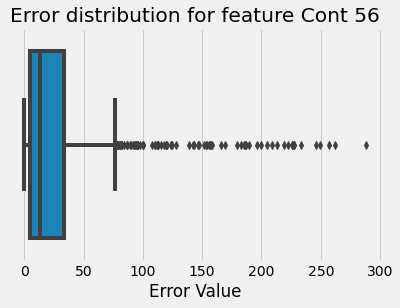

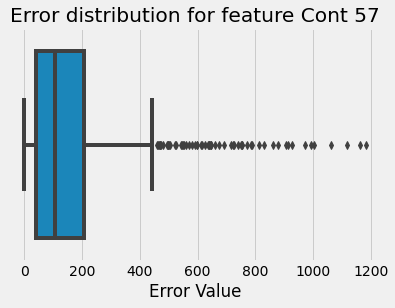

In [ ]:
error_box_plot_without_outliers('spam')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in double_scalars


     label  lower_whisker  median  upper_whisker  median_pos
0  Private            0.0     0.0            0.0         NaN
  label  lower_whisker  median  upper_whisker  median_pos
0  Apps           18.2  464.16        1831.39   25.599082
    label  lower_whisker   median  upper_whisker  median_pos
0  Accept         24.321  398.695        1243.75    32.69522
    label  lower_whisker    median  upper_whisker  median_pos
0  Enroll           1.14  172.1905         556.22   31.020844
       label  lower_whisker  median  upper_whisker  median_pos
0  Top10perc         0.0064  4.3906        18.1548   24.192766
       label  lower_whisker   median  upper_whisker  median_pos
0  Top25perc         0.0178  7.70815        29.1087   26.496774
         label  lower_whisker  median  upper_whisker  median_pos
0  F.Undergrad           10.2  611.41        2121.69   28.956329
         label  lower_whisker   median  upper_whisker  median_pos
0  P.Undergrad          7.405  346.766        1063.29   32.841266


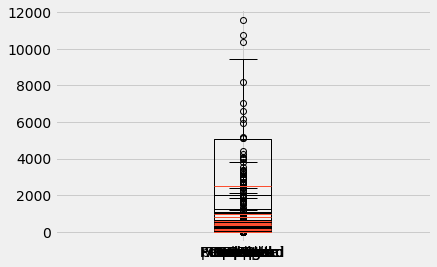

In [ ]:
dataset = 'college'
filename = dataset + '/' + dataset +'.csv'

original_df = pd.read_csv(filename)
all_col_names = original_df.columns.to_list()

mis_col_names = [i+'_mis' for i in all_col_names]
imp_col_names = [i+'_imp' for i in all_col_names]

miss_filename = dataset +'/missing.csv'
imp_filename = dataset +'/imputed.csv'
miss_df = pd.read_csv(miss_filename,names= mis_col_names)
imp_df = pd.read_csv(imp_filename,names= imp_col_names)

df4 = original_df.join(miss_df)
combined_df = df4.join(imp_df)
features = all_col_names

def get_box_plot_data(labels, bp):
    rows_list = []

    for i in range(len(labels)):
        dict1 = {}
        dict1['label'] = labels[i]
        dict1['lower_whisker'] = bp['whiskers'][i*2].get_ydata()[1]
        #dict1['lower_quartile'] = bp['boxes'][i].get_ydata()[1]
        dict1['median'] = bp['medians'][i].get_ydata()[1]
        #dict1['upper_quartile'] = bp['boxes'][i].get_ydata()[2]
        dict1['upper_whisker'] = bp['whiskers'][(i*2)+1].get_ydata()[1]
        dict1['median_pos'] = dict1['median'] / (dict1['upper_whisker'] - dict1['lower_whisker']) * 100
        rows_list.append(dict1)

    return pd.DataFrame(rows_list)

labels = all_col_names
for i in all_col_names:
  nan_df = combined_df[np.isnan(combined_df[i + '_mis'])][[i + '_imp',i]]
  nan_df['diff'] = abs(nan_df[i] - nan_df[i + '_imp'])
  nan_df['diff_zscore'] = stats.zscore(nan_df['diff'])
  nan_df = nan_df[nan_df['diff_zscore'] <= 3]
  bp = plt.boxplot(nan_df['diff'], labels=[i])
  print(get_box_plot_data([i], bp))
#plt.show()

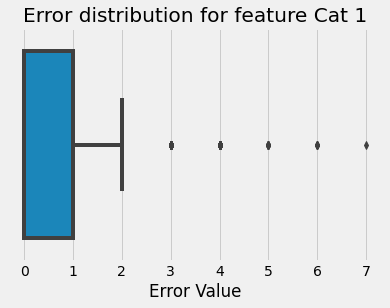

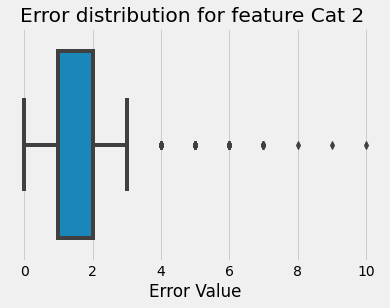

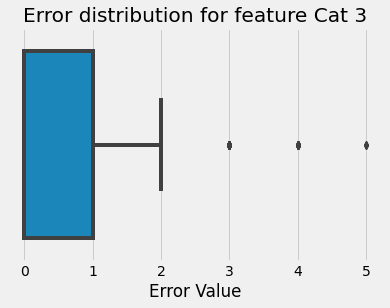

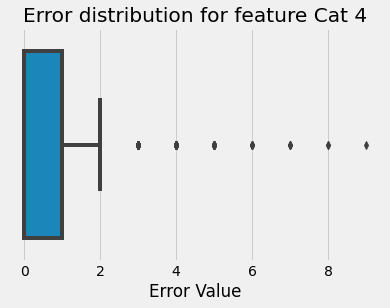

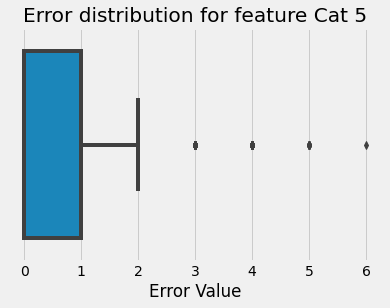

...

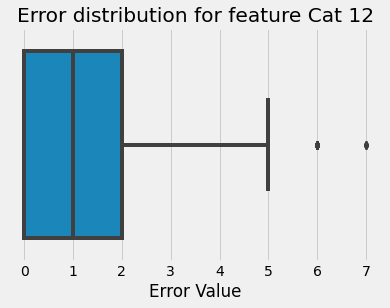

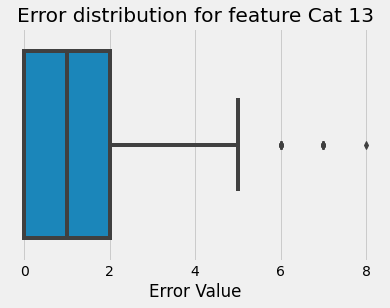

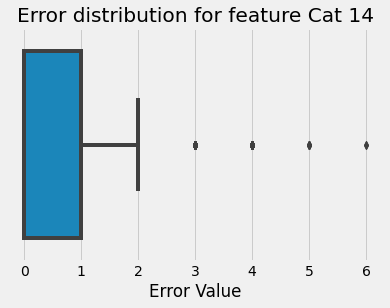

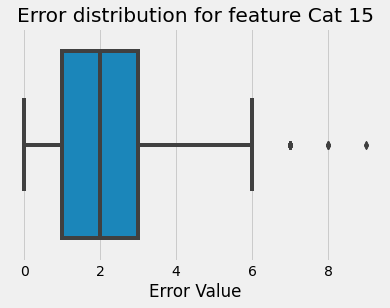

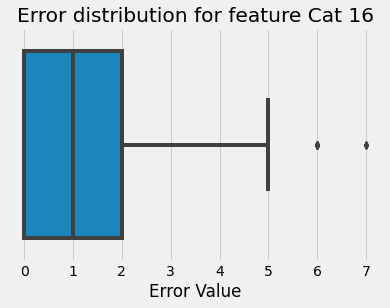

In [ ]:
error_box_plot('letter')

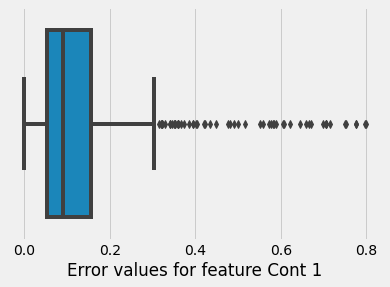

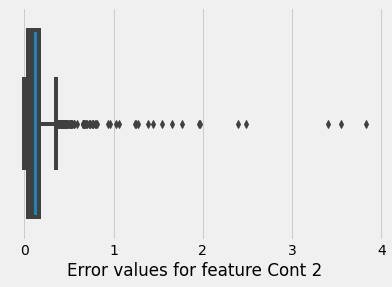

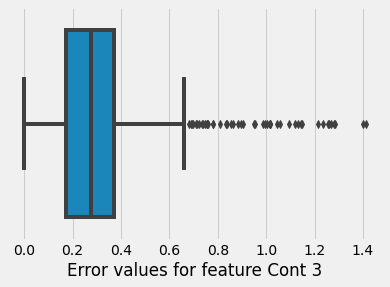

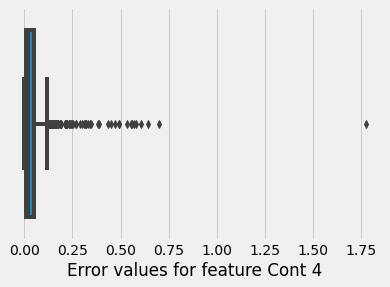

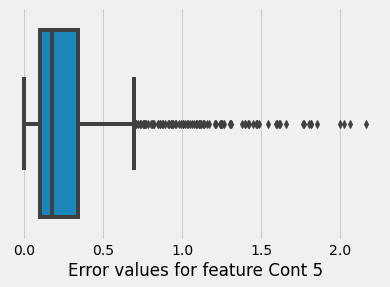

...

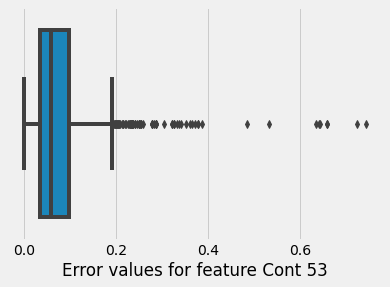

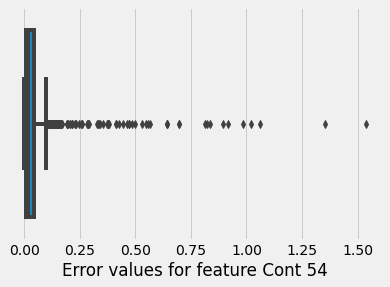

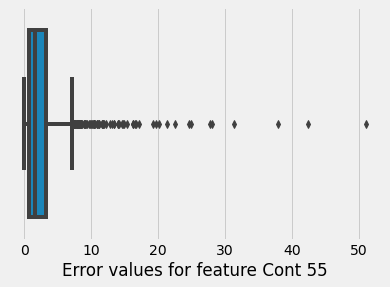

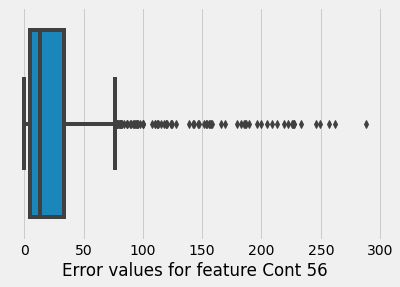

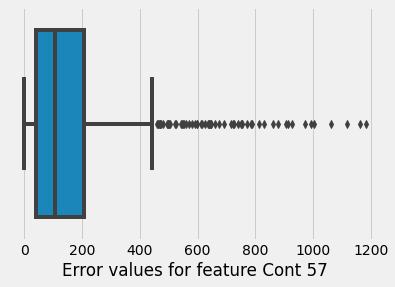

In [ ]:
error_box_plot_without_outliers('spam')